In [ ]:
# ## Import libraries
# import warnings
# warnings.simplefilter(action='ignore')
# import os
import zipfile
# from shutil import copyfile
# import random

# import numpy as np
# import cv2
# import matplotlib.pyplot as plt
# %matplotlib inline
# import seaborn as sns
# from sklearn.metrics import ConfusionMatrixDisplay


# import tensorflow as tf
# from tensorflow.keras.optimizers import Adam, Nadam, RMSprop
# from tensorflow.keras.models import Model
# from tensorflow.keras.layers import Input
# from tensorflow.keras.layers import Conv2D, MaxPooling2D, Activation, Dense, BatchNormalization, GlobalAveragePooling2D
# from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [1]:
## Conection with Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
## Load and extract the dataset
input_path = "/content/drive/MyDrive/dataset.zip"

local_zip = input_path
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('/content/drive/MyDrive/')
zip_ref.close()

NameError: name 'zipfile' is not defined

In [ ]:
## Load and extract the dataset
input_path = "/content/drive/MyDrive/Splitted_data2.zip"

local_zip = input_path
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('/content/drive/MyDrive/')
zip_ref.close()

In [3]:
# General utilities
import warnings  # To suppress warnings
warnings.simplefilter(action='ignore')  # Suppress warnings globally
import os  # For operating system interactions (e.g., file paths)
import random  # For randomization

# Data manipulation and mathematical operations
import numpy as np  # For numerical computations

# Image processing
import cv2  # OpenCV for image processing
import zipfile
from shutil import copyfile
# Visualization libraries

import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns  # For enhanced visualizations
from sklearn.metrics import ConfusionMatrixDisplay  # For visualizing confusion matrices

# TensorFlow and Keras (Deep Learning Framework)
import tensorflow as tf  # TensorFlow core library
from tensorflow.keras.optimizers import Adam, Nadam, RMSprop  # Optimizers for model training
from tensorflow.keras.models import Model  # Base class for Keras models
from tensorflow.keras.layers import (  # Neural network layers
    Input,
    Conv2D,
    MaxPooling2D,
    Activation,
    Dense,
    BatchNormalization,
    GlobalAveragePooling2D
)
from tensorflow.keras.preprocessing.image import ImageDataGenerator  # For data augmentation and preprocessing


In [ ]:
                                                                                                      n_health))

Directories already exist!


In [4]:
# // Shorrtcut varibales for path
data_dir = "/content/drive/MyDrive/Splitted_data2/"
SavedModels_MOBILENETV2 = "/content/drive/MyDrive/SavedModels/MOBILENETV2"
data_path = "/content/drive/MyDrive/dataset"

#### **Diplay some images**

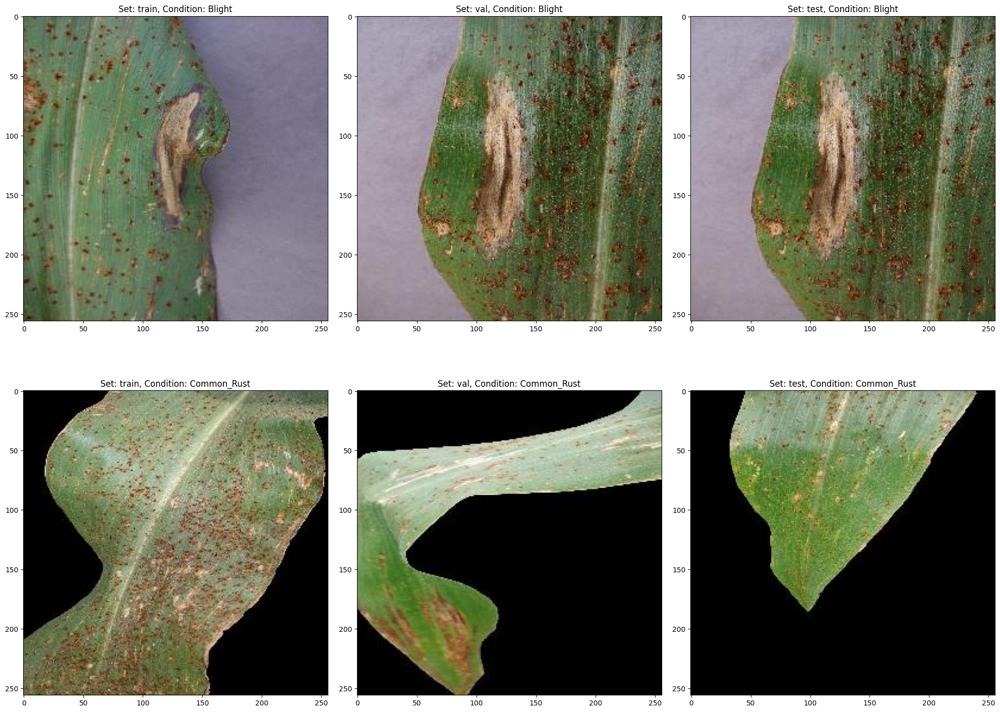

In [5]:
##
# This code visualizes sample images from two conditions (Blight and Common Rust) for each dataset split (train, val, and test)
path_ = data_dir+'/'

fig, ax = plt.subplots(2,3,figsize=(20,15))
ax = ax.ravel()
plt.tight_layout()
# Set up the plotting environment:
for i, set_ in enumerate(['train','val', 'test']):
    set_path = path_+ set_
    # Display images for the "Blight" condition:
    ax[i].imshow(plt.imread(set_path+'/Blight/'+os.listdir(set_path+'/Blight')[0]))
    ax[i].set_title('Set: {}, Condition: Blight'.format(set_))
    # Display images for the "Common Rust" condition:
    ax[i+3].imshow(plt.imread(set_path+'/Common_Rust/'+os.listdir(set_path+'/Common_Rust')[0]))
    ax[i+3].set_title('Set: {}, Condition: Common_Rust'.format(set_))

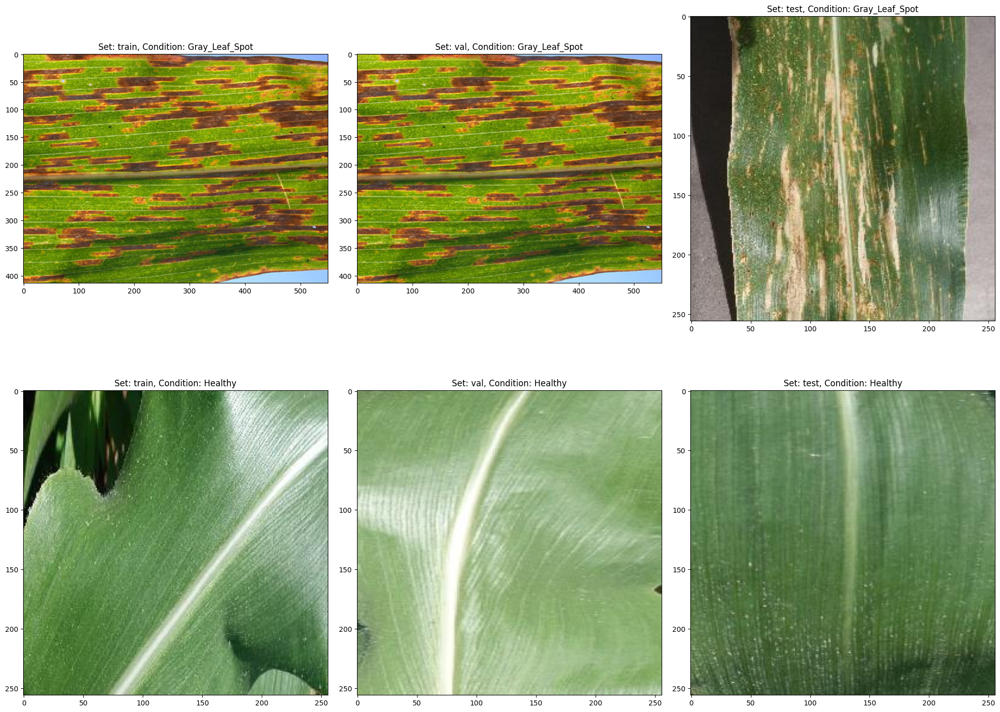

In [6]:
fig, ax = plt.subplots(2,3,figsize=(20,15))
ax = ax.ravel()
plt.tight_layout()

for i, set_ in enumerate(['train','val','test']):
    set_path = path_+ set_
    # Display images for the Gray_Leaf_Spot condition:
    ax[i].imshow(plt.imread(set_path+'/Gray_Leaf_Spot/'+os.listdir(set_path+'/Gray_Leaf_Spot')[0]))
    ax[i].set_title('Set: {}, Condition: Gray_Leaf_Spot'.format(set_))
    # Display images for the Healthy condition:
    ax[i+3].imshow(plt.imread(set_path+'/Healthy/'+os.listdir(set_path+'/Healthy')[0]))
    ax[i+3].set_title('Set: {}, Condition: Healthy'.format(set_))

In [7]:

# to create training and validation data generators for image data preprocessing.
def train_val_test_data(img_dims, batch_size):

  ## Training data generator with augmentationa
  train_datagen = ImageDataGenerator(rescale = 1./255,
                                       rotation_range = 40, # Randomly rotate images by up to 40 degrees.
                                       width_shift_range = .2,
                                       height_shift_range = .2,
                                       shear_range = .2,# Apply random shearing transformations.
                                       zoom_range = 0.3,
                                       horizontal_flip = True,
                                       vertical_flip=True,
                                       brightness_range=[0.5, 1.5], # Randomly adjust brightness within the specified range.
                                       featurewise_center=True,
                                       featurewise_std_normalization=True, # Normalize images based on dataset standard deviation.
                                       fill_mode = 'nearest', # Fill missing pixels after transformations with the nearest pixel value.
                                   )


  ## Train generator
  train_gen = train_datagen.flow_from_directory(directory = path_ + 'train',
                                                  target_size = (img_dims, img_dims),  # Resize all images to the specified dimensions.
                                                  batch_size = batch_size,  # Number of images per batch.
                                                  class_mode = 'categorical', # Multi-class classification mode; one-hot encodes labels.
                                                  shuffle = True) # Shuffle the data to enhance randomness during training.

  ## Validation Data minimal preprocessing, no augmentation)
  validation_datagen = ImageDataGenerator(rescale = 1./255)

  ## validation generator
  val_gen = validation_datagen.flow_from_directory(directory = path_ + 'val',
                                                      target_size = (img_dims, img_dims),
                                                      batch_size = batch_size,
                                                      class_mode = 'categorical',
                                                      shuffle = True)
  ## Test data generator (minimal preprocessing, no augmentation)
  test_datagen = ImageDataGenerator(rescale=1./255)
  ## Test generator
  test_gen = test_datagen.flow_from_directory(
        directory=path_ + 'test',  # Path to the test directory.
        target_size=(img_dims, img_dims),  # Resize test images.
        batch_size=batch_size,  # Number of test images per batch.
        class_mode='categorical',  # Ensure categorical labels are returned.
        shuffle=False  # Do not shuffle test data to maintain order for evaluation.
    )


  return train_gen, val_gen, test_gen

In [14]:
# ## Import the test set
# input_test = '/content/drive/MyDrive/Splitted_data2/test'
# labels = os.listdir(input_test)

# def get_data(data_dir):
#     data = []
#     for label in labels:
#         path = os.path.join(data_dir, label)
#         if not os.path.isdir(path):  # Skip non-directory entries
#             continue
#         class_num = labels.index(label)
#         for img in os.listdir(path):
#             try:
#                 # Read image and convert BGR to RGB
#                 img_arr = cv2.imread(os.path.join(path, img))[..., ::-1]
#                 if img_arr is None:
#                     print(f"Warning: Unable to read image {os.path.join(path, img)}")
#                     continue
#                 # Resize image
#                 resized_arr = cv2.resize(img_arr, (img_dims, img_dims))
#                 # Append image and label
#                 data.append([resized_arr, class_num])
#             except Exception as e:
#                 print(f"Error processing file {os.path.join(path, img)}: {e}")
#     return data  # Keep as list to avoid NumPy conversion issues

# # Reload test data
# test_set_ = get_data(input_test)

# # Extract features and labels
# X_test, y_test = zip(*test_set_)
# X_test = np.array(X_test) / 255.0  # Normalize pixel values
# y_test = np.array(y_test)


In [9]:
# Set the dimensions for resizing images and the batch size for data generators
img_dims = 224  # The dimensions (224x224) to which all images will be resized.
batch_size = 128 # Number of images in each batch for training and validation.

# Call the train_val_test_data function to create data generators
train_gen, val_gen , test_gen= train_val_test_data(img_dims, batch_size)

Found 4037 images belonging to 4 classes.
Found 800 images belonging to 4 classes.
Found 803 images belonging to 4 classes.


## **Modeling**

- Transfer learning (MobileNetV2 architecture)
- Fine-tuning


In [10]:
## Choose a device type (CPU or GPU)
# devices = tf.config.list_physical_devices('GPU')
# print(devices[0])

# ## Name divice
# name_gpu = "GPU:0"

# ## Define my strategy like One Device Strategy
# strategy = tf.distribute.OneDeviceStrategy(device=name_gpu)



# List all physical devices of type 'GPU' available in the system
devices = tf.config.list_physical_devices('GPU')
if devices:
    print("GPU available:", devices[0])
    name_gpu = "GPU:0"
    # Create a distribution strategy for running computations on the GPU
    strategy = tf.distribute.OneDeviceStrategy(device=name_gpu)
else:
    print("No GPU found. Using CPU instead.")
    strategy = tf.distribute.OneDeviceStrategy(device="CPU")

GPU available: PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


In [11]:
def mobilenetv2():
# Load the pre-trained MobileNetV2 model
  mobilenet_m = tf.keras.applications.mobilenet_v2.MobileNetV2(input_shape=(
        img_dims,img_dims,3),
        include_top = False, # Exclude the fully connected layers at the top
        weights = 'imagenet' # Load pre-trained weights from ImageNet
      )
  x = mobilenet_m.trainable = False # Ensures the pre-trained layers are not updated during training

  # Get the output of the MobileNetV2 base model
  x = mobilenet_m.output

# Add a global average pooling layer to reduce the spatial dimensions
  x = GlobalAveragePooling2D()(x)

  # Add a fully connected output layer with softmax activation for multi-class classification
  out = Dense(4,activation='softmax')(x)

 # Create the final model by specifying inputs and outputs
  model = Model(inputs = mobilenet_m.inputs, outputs = out)

  # Print the model architecture summary for verification
  model.summary()

  return model

In [12]:
# Use the distribution strategy scope for efficient computation on the specified device (GPU/CPU)

with strategy.scope():
  # Create the MobileNetV2 model using the defined function
  mobilenetv2_model = mobilenetv2()
  # Compile the model
  mobilenetv2_model.compile(loss = 'categorical_crossentropy', optimizer = Adam(learning_rate = .0001),metrics = ['accuracy'])

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1 (Conv2D)            │ (None, 112, 112, 32)   │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bn_Conv1                  │ (None, 112, 112, 32)   │            128 │ Conv1[0][0]            │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1_relu (ReLU)         │ (None, 112, 112, 32)   │              0 │ bn_Conv1[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise   │ (None, 112, 112, 32)   │            288 │ Conv1_relu[0][0]       │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 112, 112, 32)   │            128 │ expanded_conv_depthwi… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 112, 112, 32)   │              0 │ expanded_conv_depthwi… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project     │ (None, 112, 112, 16)   │            512 │ expanded_conv_depthwi… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project_BN  │ (None, 112, 112, 16)   │             64 │ expanded_conv_project… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand (Conv2D)   │ (None, 112, 112, 96)   │          1,536 │ expanded_conv_project… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_BN         │ (None, 112, 112, 96)   │            384 │ block_1_expand[0][0]   │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_relu       │ (None, 112, 112, 96)   │              0 │ block_1_expand_BN[0][… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_pad               │ (None, 113, 113, 96)   │              0 │ block_1_expand_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise         │ (None, 56, 56, 96)     │            864 │ block_1_pad[0][0]      │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise_BN 

 Total params: 2,263,108 (8.63 MB)

 Trainable params: 5,124 (20.02 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

In [13]:
epochs_1 = 50

### **Train the MobileNetV2 model**

In [14]:

# history_1 = mobilenetv2_model.fit(train_gen, steps_per_epoch=train_gen.samples // batch_size,
#                                epochs=epochs_1, validation_data=(val_gen),
#                                validation_steps=val_gen.samples // batch_size
#
from math import ceil # Import the ceil function to round up numbers to the nearest integer

# Calculate the number of steps per epoch for training
steps_per_epoch = ceil(train_gen.samples / batch_size)
validation_steps = ceil(val_gen.samples / batch_size)
# `val_gen.samples`: Total number of validation samples in the dataset
# The same logic as `steps_per_epoch` applies here to cover all validation samples.

# Train the model using the training and validation data generators
history_1 = mobilenetv2_model.fit(
    train_gen,
    steps_per_epoch=steps_per_epoch,  # Number of batches to process per epoch
    epochs=epochs_1,
    validation_data=val_gen,
    validation_steps=validation_steps # Number of validation batches to process per epoch
)


Epoch 1/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 505s 16s/step - accuracy: 0.2212 - loss: 1.8112 - val_accuracy: 0.3452 - val_loss: 1.4592
Epoch 2/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 86s 2s/step - accuracy: 0.4648 - loss: 1.2232 - val_accuracy: 0.5491 - val_loss: 1.1430
Epoch 3/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 5s 155ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.5580 - val_loss: 1.1182
Epoch 4/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 85s 2s/step - accuracy: 0.6368 - loss: 0.9687 - val_accuracy: 0.6726 - val_loss: 0.9345
Epoch 5/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 5s 157ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.6830 - val_loss: 0.9075
Epoch 6/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 136s 2s/step - accuracy: 0.7076 - loss: 0.8280 - val_accuracy: 0.7128 - val_loss: 0.8020
Epoch 7/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 6s 175ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.7143 - val_loss: 0.8055
Epoch 8/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 88s 2s/step - accuracy: 0.7582 - loss: 0.7070 -

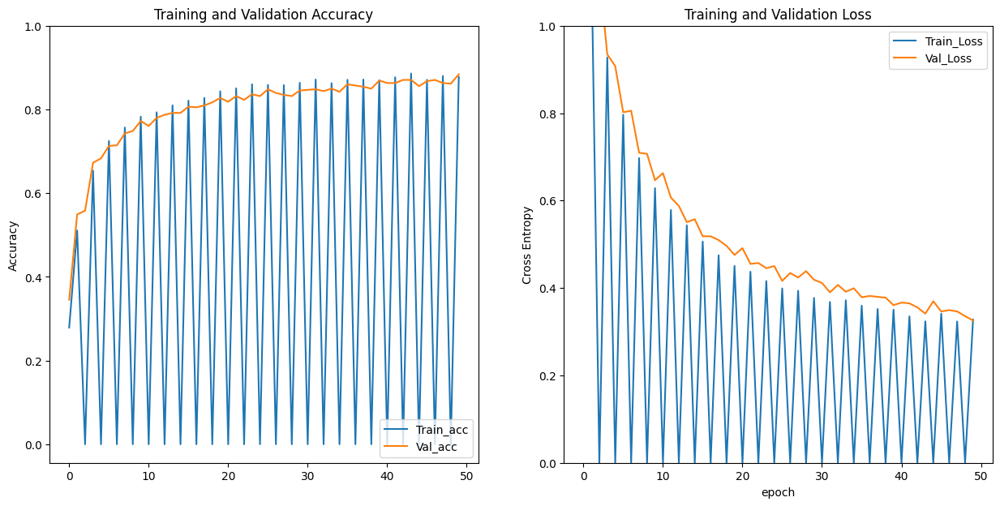

In [15]:
### Loss and accuracy plot

# Extract accuracy values from the training history
acc_mob = history_1.history['accuracy']
val_acc_mob = history_1.history['val_accuracy']


# Extract loss values from the training history
loss_mob = history_1.history['loss']
val_loss_mob = history_1.history['val_loss']

# Plot training and validation accuracy
plt.figure(figsize=(15, 7))
plt.subplot(1, 2, 1)
plt.plot(acc_mob, label='Train_acc')
plt.plot(val_acc_mob, label='Val_acc')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

# Plot training and validation loss
plt.subplot(1, 2, 2)
plt.plot(loss_mob, label='Train_Loss')
plt.plot(val_loss_mob, label='Val_Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [16]:
result_eval = mobilenetv2_model.evaluate(val_gen, verbose =0)

for metric, eval in zip(mobilenetv2_model.metrics_names, result_eval):
  print(metric + ': {:.3}'.format(eval))

loss: 0.341
compile_metrics: 0.87


In [19]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

## Generate predictions using the test data generator
test_predictions = mobilenetv2_model.predict(test_gen)  # Predict probabilities
test_pred_classes = np.argmax(test_predictions, axis=1)  # Get predicted class indices
test_true_classes = test_gen.classes  # True class labels from the test generator

7/7 ━━━━━━━━━━━━━━━━━━━━ 5s 672ms/step


In [20]:

# Define the class labels
class_labels = list(test_gen.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(test_true_classes, test_pred_classes)


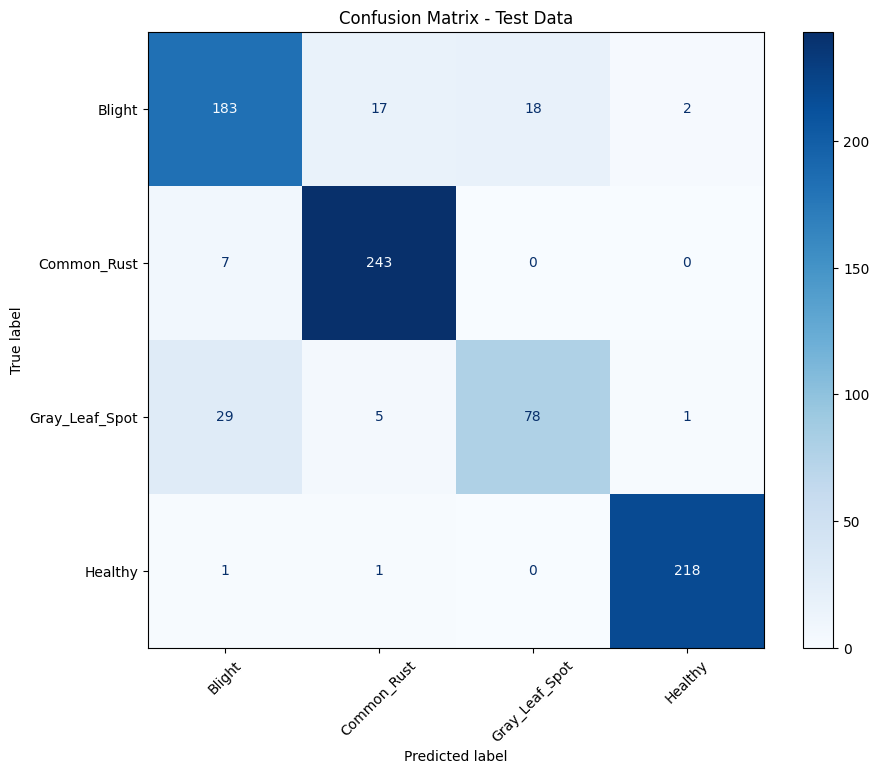

In [21]:
# Plot the confusion matrix
plt.figure(figsize=(10, 8))  # Set figure size
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap='Blues', xticks_rotation=45, ax=plt.gca())  # Plot the confusion matrix
plt.title('Confusion Matrix - Test Data')  # Add a title
plt.show()


In [22]:
from sklearn.metrics import classification_report

# Generate predictions on the test data
test_predictions = mobilenetv2_model.predict(test_gen)  # Predict probabilities on the test data
test_pred_classes = np.argmax(test_predictions, axis=1)  # Get the predicted class indices
test_true_classes = test_gen.classes  # True class labels from the test generator

# Define the class labels (update with your actual class names if necessary)
class_labels = list(test_gen.class_indices.keys())

# Generate the classification report
report = classification_report(test_true_classes, test_pred_classes, target_names=class_labels)

# Print the classification report
print("Classification Report - Test Data:\n")
print(report)


7/7 ━━━━━━━━━━━━━━━━━━━━ 4s 573ms/step
Classification Report - Test Data:

                precision    recall  f1-score   support

        Blight       0.83      0.83      0.83       220
   Common_Rust       0.91      0.97      0.94       250
Gray_Leaf_Spot       0.81      0.69      0.75       113
       Healthy       0.99      0.99      0.99       220

      accuracy                           0.90       803
     macro avg       0.89      0.87      0.88       803
  weighted avg       0.90      0.90      0.90       803



In [23]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Generate predictions on the test data
test_predictions = mobilenetv2_model.predict(test_gen)  # Predict probabilities on the test data
test_pred_classes = np.argmax(test_predictions, axis=1)  # Get the predicted class indices
test_true_classes = test_gen.classes  # True class labels from the test generator

# Calculate metrics
accuracy = accuracy_score(test_true_classes, test_pred_classes)
precision = precision_score(test_true_classes, test_pred_classes, average='weighted')
recall = recall_score(test_true_classes, test_pred_classes, average='weighted')
f1 = f1_score(test_true_classes, test_pred_classes, average='weighted')

# Print metrics
print("Model Evaluation Metrics - Test Data:")
print(f"Accuracy:  {accuracy*100:.2f}%")
print(f"Precision: {precision*100:.2f}%")
print(f"Recall:    {recall*100:.2f}%")
print(f"F1-Score:  {f1*100:.2f}%")


7/7 ━━━━━━━━━━━━━━━━━━━━ 4s 568ms/step
Model Evaluation Metrics - Test Data:
Accuracy:  0.899
Precision: 0.897
Recall:    0.899
F1-Score:  0.897


### **Fine-tuning the model**
- Un-freeze the top layers of MobileNetV2 model
- training:
  - Total epochs = 75
  - Adam optimazer with a low learning rate (base_learning_rate/10) to avoid the overfitting

In [24]:
## Unfreezing layers
mobilenetv2_model.trainable = True

In [25]:
## Fine-tuning
## number of layer in the pre-trained model
print('Number of layer in the pre-trained model:{}'.format(len(mobilenetv2_model.layers)))
fine_tune_at = 100

for layer in mobilenetv2_model.layers[:fine_tune_at]:
  layer.trainable = False
print(f"Trainable Layers: {len(mobilenetv2_model.trainable_variables)}")

Number of layer in the pre-trained model:156
Trainable Layers: 2


In [26]:
with strategy.scope():

  mobilenetv2_model.summary()
  mobilenetv2_model.compile(loss = 'categorical_crossentropy', optimizer = Adam(learning_rate = 0.0001/10),metrics = ['accuracy'])

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1 (Conv2D)            │ (None, 112, 112, 32)   │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bn_Conv1                  │ (None, 112, 112, 32)   │            128 │ Conv1[0][0]            │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv1_relu (ReLU)         │ (None, 112, 112, 32)   │              0 │ bn_Conv1[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise   │ (None, 112, 112, 32)   │            288 │ Conv1_relu[0][0]       │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 112, 112, 32)   │            128 │ expanded_conv_depthwi… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_depthwise_… │ (None, 112, 112, 32)   │              0 │ expanded_conv_depthwi… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project     │ (None, 112, 112, 16)   │            512 │ expanded_conv_depthwi… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ expanded_conv_project_BN  │ (None, 112, 112, 16)   │             64 │ expanded_conv_project… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand (Conv2D)   │ (None, 112, 112, 96)   │          1,536 │ expanded_conv_project… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_BN         │ (None, 112, 112, 96)   │            384 │ block_1_expand[0][0]   │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_expand_relu       │ (None, 112, 112, 96)   │              0 │ block_1_expand_BN[0][… │
│ (ReLU)                    │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_pad               │ (None, 113, 113, 96)   │              0 │ block_1_expand_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise         │ (None, 56, 56, 96)     │            864 │ block_1_pad[0][0]      │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block_1_depthwise_BN 

 Total params: 2,273,358 (8.67 MB)

 Trainable params: 5,124 (20.02 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

 Optimizer params: 10,250 (40.04 KB)

In [27]:
## Training
# fine_tune_epochs = 25
# total_epochs = epochs_1 + fine_tune_epochs

# history_fine = mobilenetv2_model.fit(train_gen, steps_per_epoch=train_gen.samples // batch_size,
#                                             epochs=total_epochs,
#                                             initial_epoch = history_1.epoch[-1],
#                                             validation_data=(val_gen),
#                                             validation_steps=val_gen.samples // batch_size,
#                                     )


from math import ceil

# Calculate the correct steps per epoch and validation steps
steps_per_epoch = ceil(train_gen.samples / batch_size)
validation_steps = ceil(val_gen.samples / batch_size)

# Perform fine-tuning
fine_tune_epochs = 25
total_epochs = len(history_1.epoch) + fine_tune_epochs  # len(history_1.epoch) = 50

history_fine = mobilenetv2_model.fit(
    train_gen,
    steps_per_epoch=steps_per_epoch,
    epochs=total_epochs,
    initial_epoch=len(history_1.epoch),  # Start fine-tuning after the initial training
    validation_data=val_gen,
    validation_steps=validation_steps,
)


Epoch 51/75
32/32 ━━━━━━━━━━━━━━━━━━━━ 69s 2s/step - accuracy: 0.8789 - loss: 0.3417 - val_accuracy: 0.8735 - val_loss: 0.3373
Epoch 52/75
32/32 ━━━━━━━━━━━━━━━━━━━━ 82s 2s/step - accuracy: 0.8720 - loss: 0.3421 - val_accuracy: 0.8750 - val_loss: 0.3356
Epoch 53/75
32/32 ━━━━━━━━━━━━━━━━━━━━ 5s 147ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8750 - val_loss: 0.3380
Epoch 54/75
32/32 ━━━━━━━━━━━━━━━━━━━━ 83s 2s/step - accuracy: 0.8872 - loss: 0.3201 - val_accuracy: 0.8765 - val_loss: 0.3291
Epoch 55/75
32/32 ━━━━━━━━━━━━━━━━━━━━ 5s 162ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8690 - val_loss: 0.3283
Epoch 56/75
32/32 ━━━━━━━━━━━━━━━━━━━━ 83s 2s/step - accuracy: 0.8925 - loss: 0.3032 - val_accuracy: 0.8676 - val_loss: 0.3415
Epoch 57/75
32/32 ━━━━━━━━━━━━━━━━━━━━ 5s 171ms/step - accuracy: 0.0000e+00 - loss: 0.0000e+00 - val_accuracy: 0.8705 - val_loss: 0.3485
Epoch 58/75
32/32 ━━━━━━━━━━━━━━━━━━━━ 82s 2s/step - accuracy: 0.8918 - loss: 0.3

In [ ]:
# print(history_1.epoch)

#### **Fine-tuning model performance**
- loss and accuracy plot
- Evaluate with the validation set
- Metrics:
 - Accuracy


In [28]:
acc_mob += history_fine.history['accuracy']
val_acc_mob += history_fine.history['val_accuracy']

loss_mob += history_fine.history['loss']
val_loss_mob += history_fine.history['val_loss']


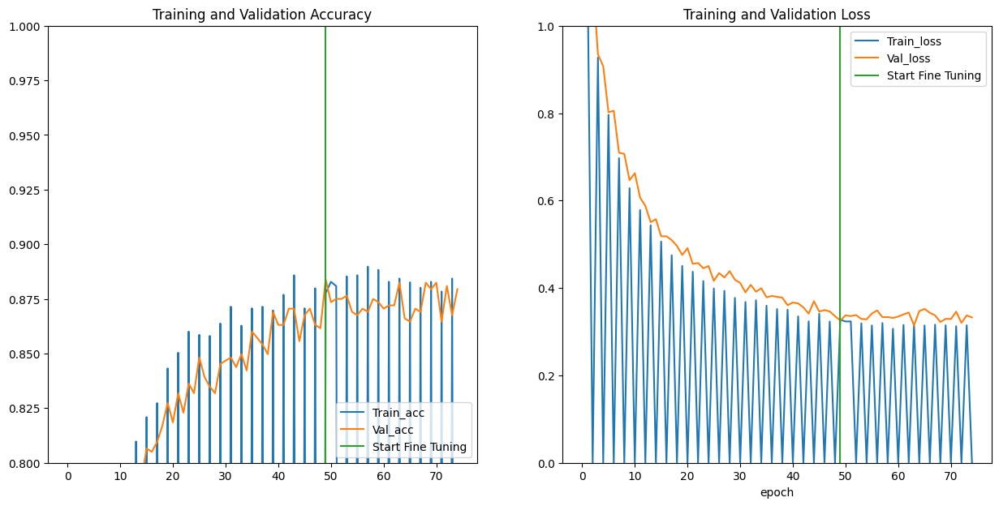

In [29]:
plt.figure(figsize=(15, 7))
plt.subplot(1, 2, 1)
plt.plot(acc_mob, label='Train_acc')
plt.plot(val_acc_mob, label='Val_acc')
plt.ylim([0.8, 1])
plt.plot([epochs_1-1,epochs_1-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(loss_mob, label='Train_loss')
plt.plot(val_loss_mob, label='Val_loss')
plt.ylim([0, 1.0])
plt.plot([epochs_1-1,epochs_1-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [30]:
result_eval_f = mobilenetv2_model.evaluate(val_gen, verbose =0)

for metric_, eval_ in zip(mobilenetv2_model.metrics_names, result_eval_f):
  print(metric_ + ': {:.3}'.format(eval_))

loss: 0.331
compile_metrics: 0.874


##### **Observations**

- The initial model with the transfer learning technique reaches a good performance(accuracy = 0.87).

- Unfreezing some layers (fine-tuning) give more performance to the model, reaching an accuracy = 0.92 and loss = 0.21 with the validation set

### **Model Evaluation with the test set**

7/7 ━━━━━━━━━━━━━━━━━━━━ 6s 498ms/step


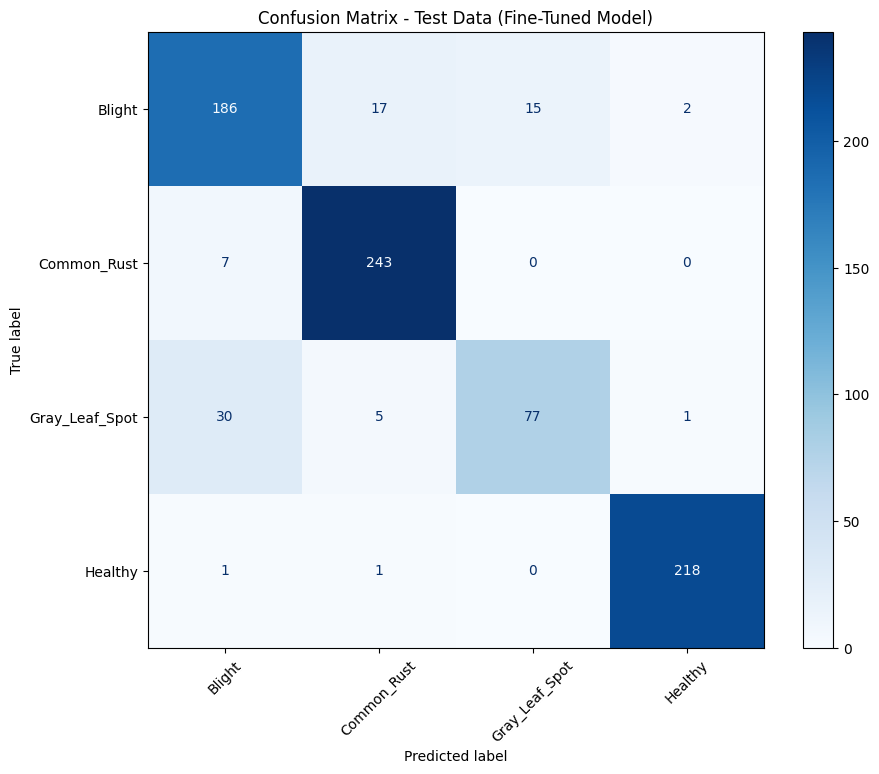

In [31]:

# Generate predictions on the test set
test_predictions = mobilenetv2_model.predict(test_gen)  # Predict probabilities on test data
test_pred_classes = np.argmax(test_predictions, axis=1)  # Convert probabilities to class indices
test_true_classes = test_gen.classes  # True class labels from the test generator

# Compute the confusion matrix
cm = confusion_matrix(test_true_classes, test_pred_classes)

# Define class labels (update with your actual class names if necessary)
class_labels = list(test_gen.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(10, 8))  # Set figure size
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap='Blues', xticks_rotation=45, ax=plt.gca())  # Plot with a blue color map
plt.title('Confusion Matrix - Test Data (Fine-Tuned Model)')
plt.show()

7/7 ━━━━━━━━━━━━━━━━━━━━ 5s 715ms/step


<Figure size 1200x600 with 0 Axes>

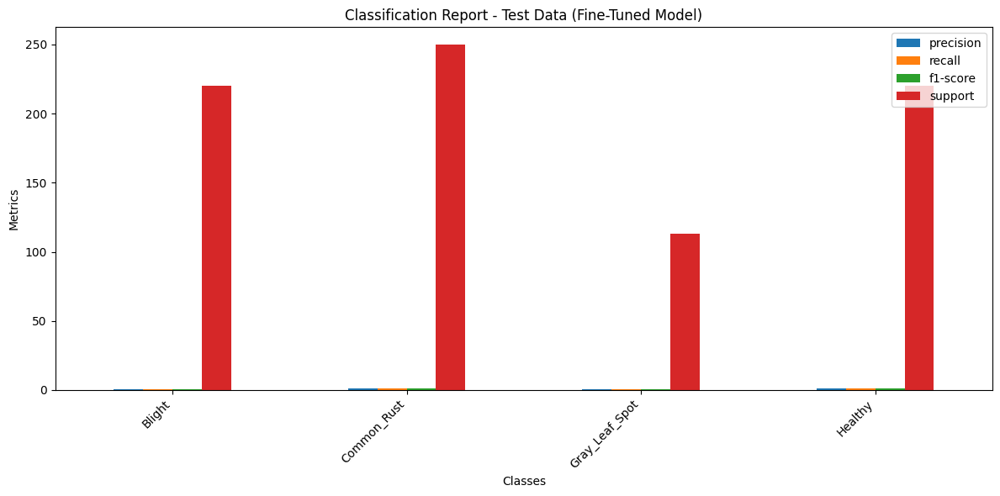

In [32]:

# Generate predictions on the test data
test_predictions = mobilenetv2_model.predict(test_gen)  # Predict probabilities on test data
test_pred_classes = np.argmax(test_predictions, axis=1)  # Convert probabilities to class indices
test_true_classes = test_gen.classes  # True class labels from the test generator

# Define class labels (update with your actual class names if necessary)
class_labels = list(test_gen.class_indices.keys())

# Generate the classification report as a dictionary
report = classification_report(test_true_classes, test_pred_classes, target_names=class_labels, output_dict=True)

# Convert the classification report dictionary to a DataFrame for plotting
import pandas as pd
report_df = pd.DataFrame(report).transpose()

# Plot the classification report
plt.figure(figsize=(12, 6))
report_df[:-3].plot(kind="bar", figsize=(12, 6))  # Exclude 'accuracy', 'macro avg', and 'weighted avg' rows
plt.title("Classification Report - Test Data (Fine-Tuned Model)")
plt.xlabel("Classes")
plt.ylabel("Metrics")
plt.xticks(rotation=45, horizontalalignment="right")
plt.legend(loc="upper right")
plt.tight_layout()
plt.show()


In [33]:
from sklearn.metrics import classification_report

# Generate predictions on the test data
test_predictions = mobilenetv2_model.predict(test_gen)  # Predict probabilities on the test data
test_pred_classes = np.argmax(test_predictions, axis=1)  # Convert probabilities to predicted class indices
test_true_classes = test_gen.classes  # True class labels from the test generator

# Define class labels (update with your actual class names if necessary)
class_labels = list(test_gen.class_indices.keys())

# Generate the classification report
report = classification_report(test_true_classes, test_pred_classes, target_names=class_labels)

# Print the classification report
print("Classification Report - Test Data (Fine-Tuned Model):\n")
print(report)


7/7 ━━━━━━━━━━━━━━━━━━━━ 4s 573ms/step
Classification Report - Test Data (Fine-Tuned Model):

                precision    recall  f1-score   support

        Blight       0.83      0.85      0.84       220
   Common_Rust       0.91      0.97      0.94       250
Gray_Leaf_Spot       0.84      0.68      0.75       113
       Healthy       0.99      0.99      0.99       220

      accuracy                           0.90       803
     macro avg       0.89      0.87      0.88       803
  weighted avg       0.90      0.90      0.90       803



In [37]:

# Generate predictions on the test data
test_predictions = mobilenetv2_model.predict(test_gen)  # Predict probabilities
test_pred_classes = np.argmax(test_predictions, axis=1)  # Get the predicted class indices
test_true_classes = test_gen.classes  # True class labels from the test generator

# Calculate metrics
accuracy = accuracy_score(test_true_classes, test_pred_classes)
precision = precision_score(test_true_classes, test_pred_classes, average='weighted')  # Weighted average precision
recall = recall_score(test_true_classes, test_pred_classes, average='weighted')  # Weighted average recall
f1 = f1_score(test_true_classes, test_pred_classes, average='weighted')  # Weighted average F1-score

# Print metrics
print("Model Evaluation Metrics - Test Data (Fine-Tuned Model):")
print(f"Accuracy:  {accuracy*100:.2f}%")
print(f"Precision: {precision*100:.2f}%")
print(f"Recall:    {recall*100:.2f}%")
print(f"F1-Score:  {f1*100:.2f}%")

7/7 ━━━━━━━━━━━━━━━━━━━━ 5s 618ms/step
Model Evaluation Metrics - Test Data (Fine-Tuned Model):
Accuracy:  90.162%
Precision: 89.994%
Recall:    90.162%
F1-Score:  89.936%


In [36]:
## Prediction
# y_pred = np.argmax(mobilenetv2_model.predict(X_test), axis = -1)

### **Final Observations**

- In general, the model reaches quite good performance with the test set, achieving an Accuracy of 94% .

- By analysing the Confusion Matrix, we can see that the model is so good at identifying Healthy leaf images (116 out of 116) and Common Rust leaf image ( 127 out of 129) with 100% and 98.44%  images correctly classified repeclty. On the other hand, the model with respect the other classes reached a performance aceptable, with 92.3% images correctly classified for Blight leaf  and 84.6% for Grey leaf spot.

### **Save the MobileNet model**

In [ ]:
# ## Save model in HDF5 format
# export_path = '/content/drive/MyDrive/Plant_Village_Dataset_Corn/save_model/model_mobnetv2'
# mobilenetv2_model.save(export_path)#export_path

In [38]:
export_path = '/content/drive/MyDrive/SavedModels/MOBILENETV2/model_mobnetv2.h5'
mobilenetv2_model.save(export_path)


In [39]:
export_path = '/content/drive/MyDrive/SavedModels/MOBILENETV2/Mymodel_mobnetv2.keras'
mobilenetv2_model.save(export_path)


In [ ]:
!pip install tf-keras-vis matplotlib



   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.5/52.5 kB 2.6 MB/s eta 0:00:00


In [ ]:
# from tensorflow.keras.models import load_model
# # Provide the path to the saved model
# model_path = 'SavedModels/Mymodel_mobnetv2.keras'
# mobilenetv2_model = load_model(model_path)

# print("Model loaded successfully!")


Model loaded successfully!


In [113]:
# mobilenetv2_model.summary()

In [41]:
from tensorflow.keras.preprocessing.image import img_to_array, load_img
import numpy as np

# Load and preprocess a single image
img_path = data_path+'/Gray_Leaf_Spot/Corn_Gray_Spot (11).jpg'
img = load_img(img_path, target_size=(224, 224))  # Resize to input size
img_array = img_to_array(img) / 255.0  # Normalize
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension



predictions = mobilenetv2_model.predict(img_array)
predicted_class = np.argmax(predictions, axis=1)  # Get the class with highest probability
print(f"Predicted class: {predicted_class}")




1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
Predicted class: [0]


In [42]:

from tensorflow.keras.preprocessing.image import ImageDataGenerator

def create_test_data(img_dims, batch_size, test_path):
    """
    Creates a test data generator for evaluating the model.

    Args:
        img_dims (int): Dimensions to resize images to (img_dims x img_dims).
        batch_size (int): Number of images per batch.
        test_path (str): Path to the test dataset directory.

    Returns:
        test_gen: A generator for the test dataset.
    """
    test_datagen = ImageDataGenerator(rescale=1./255)

    # Test generator
    test_gen = test_datagen.flow_from_directory(
        directory=test_path,
        target_size=(img_dims, img_dims),
        batch_size=batch_size,
        class_mode='categorical',
        shuffle=False  # Do not shuffle for test data
    )
    return test_gen

# Define path to the test dataset
test_path =  path_+'test'  # Ensure 'test/' exists within your dataset structure

# Create test generator
test_gen = create_test_data(img_dims, batch_size, test_path)

# Verify test generator
print(f"Test samples: {test_gen.samples}")

test_loss, test_accuracy = mobilenetv2_model.evaluate(test_gen)
print(f"Test Loss: {test_loss}, Test Accuracy: {test_accuracy}")


# Fetch a batch of images and labels from the test generator
image_batch, label_batch = next(test_gen)

print(f"Image batch shape: {image_batch.shape}")
print(f"Label batch shape: {label_batch.shape}")






Found 803 images belonging to 4 classes.
Test samples: 803
7/7 ━━━━━━━━━━━━━━━━━━━━ 6s 823ms/step - accuracy: 0.8829 - loss: 0.3006
Test Loss: 0.26407670974731445, Test Accuracy: 0.9016189575195312
Image batch shape: (128, 224, 224, 3)
Label batch shape: (128, 4)


In [44]:
model = mobilenetv2_model

# LIME Implementation with MobileNet v2

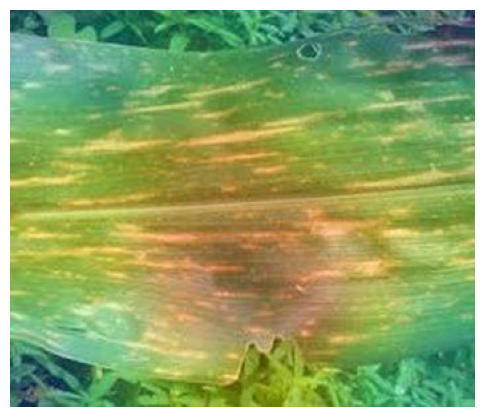

In [45]:
import numpy as np
import tensorflow as tf
from tensorflow.keras import backend as K
import matplotlib.pyplot as plt
import cv2
from tensorflow.keras.models import load_model
from matplotlib import cm

# Grad-CAM++ Function
def make_gradcamplus_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        model.inputs,
        [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        # Forward pass to get the feature maps and predictions
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # Compute first, second, and third order gradients
    grads = tape.gradient(class_channel, last_conv_layer_output)  # First-order gradients
    grads_squared = tf.square(grads)                              # Second-order gradients
    grads_cubed = grads * grads_squared                           # Third-order gradients

    # Pool gradients
    alpha_num = grads_squared  # Numerator of alphas
    alpha_denom = 2 * grads_squared + last_conv_layer_output * grads_cubed + 1e-8  # Denominator of alphas
    alphas = alpha_num / alpha_denom  # Alpha values

    # Compute weights
    weights = tf.reduce_sum(alphas * tf.maximum(grads, 0), axis=(0, 1, 2))

    # Compute the Grad-CAM++ heatmap
    last_conv_layer_output = last_conv_layer_output[0]  # Shape: (H, W, N)
    heatmap = np.dot(last_conv_layer_output, weights)

    # ReLU to retain only positive influences, then normalize
    heatmap = np.maximum(heatmap, 0)
    heatmap = heatmap / np.max(heatmap) if np.max(heatmap) != 0 else heatmap

    return heatmap

# Helper function to load image and preprocess
def get_img_array(img_path, size):
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=(size, size))
    array = tf.keras.preprocessing.image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    array = array / 255.0
    return array

# Helper function to save and display Grad-CAM++
def save_and_display_gradcam(img_path, heatmap, cam_path="cam.jpg", alpha=0.4):
    img = tf.keras.preprocessing.image.load_img(img_path)
    img = tf.keras.preprocessing.image.img_to_array(img)

    heatmap = np.uint8(255 * heatmap)
    jet = cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)
    superimposed_img.save(cam_path)

    return cam_path

# Load the MobileNetV2 model


# Set parameters
img_size = 224
img_path =  img_path # Update with the image path
last_conv_layer_name = 'Conv_1'  # Last convolutional layer in MobileNetV2

# Preprocess image
img_array = get_img_array(img_path, size=img_size)

# Generate Grad-CAM++ heatmap
heatmap = make_gradcamplus_heatmap(img_array, model, last_conv_layer_name)

# Display the result
cam_path = save_and_display_gradcam(img_path, heatmap)
plt.figure(figsize=(6, 6))
plt.imshow(plt.imread(cam_path))
plt.axis('off')
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


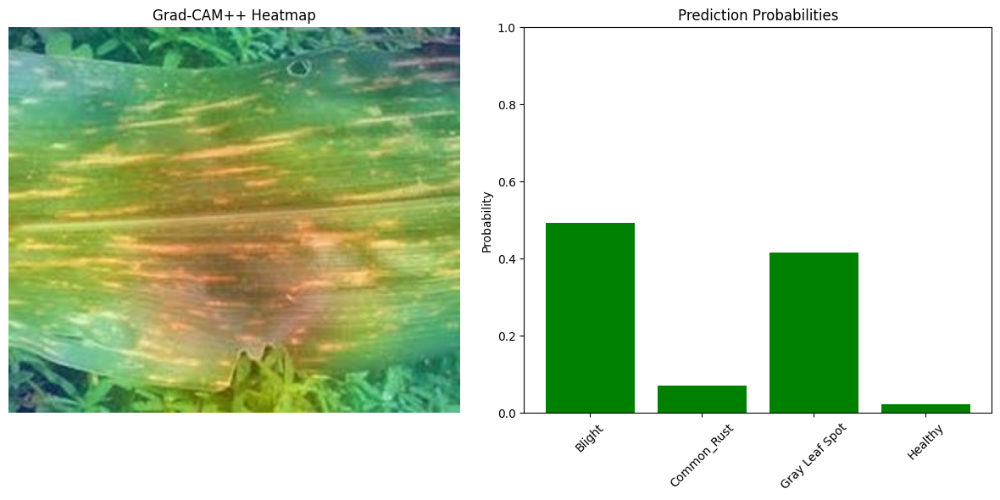

In [46]:
import matplotlib.pyplot as plt
import numpy as np

def plot_gradcam_with_probabilities(img_path, heatmap, probabilities, class_names, alpha=0.4):
    """
    Display Grad-CAM++ heatmap alongside a bar plot of class probabilities.

    Parameters:
        img_path (str): Path to the input image.
        heatmap (numpy array): Grad-CAM++ heatmap.
        probabilities (list or numpy array): Probabilities for all classes.
        class_names (list): Names of the classes.
        alpha (float): Transparency for heatmap overlay.
    """
    # Load and preprocess the image
    img = tf.keras.preprocessing.image.load_img(img_path)
    img = tf.keras.preprocessing.image.img_to_array(img)

    # Apply the heatmap to the image
    heatmap = np.uint8(255 * heatmap)
    jet = cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)

    # Create the plots
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))

    # Grad-CAM++ heatmap
    ax[0].imshow(superimposed_img)
    ax[0].axis('off')
    ax[0].set_title('Grad-CAM++ Heatmap')

    # Bar plot for probabilities
    ax[1].bar(range(len(probabilities)), probabilities, color='green')
    ax[1].set_xticks(range(len(class_names)))
    ax[1].set_xticklabels(class_names, rotation=45)
    ax[1].set_ylim(0, 1)
    ax[1].set_ylabel('Probability')
    ax[1].set_title('Prediction Probabilities')

    plt.tight_layout()
    plt.show()

# Example usage
img_path = img_path  # Update this path
class_names = ['Blight', 'Common_Rust', 'Gray Leaf Spot', 'Healthy']  # Update based on your classes
predictions = model.predict(img_array)  # Predict with your model
predicted_class_probs = predictions[0]  # Assuming batch size of 1
predicted_class_index = np.argmax(predicted_class_probs)

# Generate Grad-CAM++ heatmap
heatmap = make_gradcamplus_heatmap(img_array, model, last_conv_layer_name)

# Plot the visualization
plot_gradcam_with_probabilities(img_path, heatmap, predicted_class_probs, class_names)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


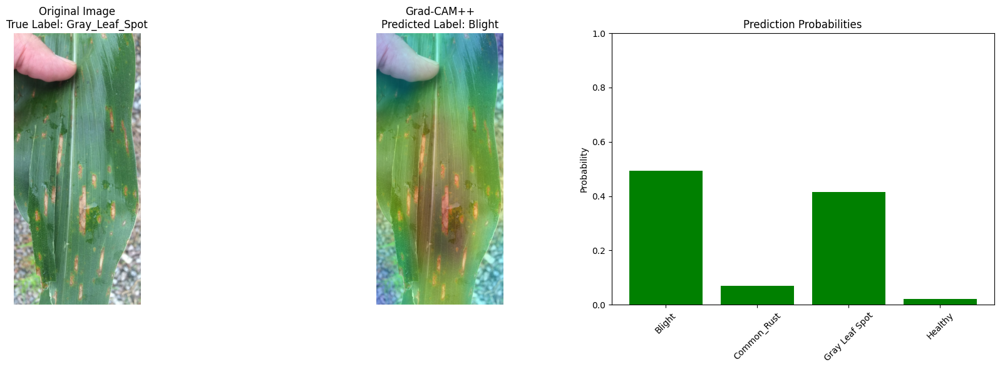

In [48]:
def plot_full_visualization(img_path, heatmap, probabilities, class_names, true_label, predicted_label, alpha=0.4):
    """
    Display the original image with the true label, Grad-CAM++ heatmap with the predicted label,
    and a bar plot for class probabilities.

    Parameters:
        img_path (str): Path to the input image.
        heatmap (numpy array): Grad-CAM++ heatmap.
        probabilities (list or numpy array): Probabilities for all classes.
        class_names (list): Names of the classes.
        true_label (str): True label of the image.
        predicted_label (str): Predicted label of the image.
        alpha (float): Transparency for heatmap overlay.
    """
    # Load the original image
    img = tf.keras.preprocessing.image.load_img(img_path)
    img_array = tf.keras.preprocessing.image.img_to_array(img)

    # Apply the heatmap to the image
    heatmap = np.uint8(255 * heatmap)
    jet = cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img_array.shape[1], img_array.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    superimposed_img = jet_heatmap * alpha + img_array
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)

    # Create the plots
    fig, ax = plt.subplots(1, 3, figsize=(18, 6))

    # Original image with true label
    ax[0].imshow(img)
    ax[0].axis('off')
    ax[0].set_title(f"Original Image\nTrue Label: {true_label}")

    # Grad-CAM++ heatmap with predicted label
    ax[1].imshow(superimposed_img)
    ax[1].axis('off')
    ax[1].set_title(f"Grad-CAM++\nPredicted Label: {predicted_label}")

    # Bar plot for probabilities
    ax[2].bar(range(len(probabilities)), probabilities, color='green')
    ax[2].set_xticks(range(len(class_names)))
    ax[2].set_xticklabels(class_names, rotation=45)
    ax[2].set_ylim(0, 1)
    ax[2].set_ylabel('Probability')
    ax[2].set_title('Prediction Probabilities')

    plt.tight_layout()
    plt.show()

# Example usage
img_path = data_path+'/Gray_Leaf_Spot/Corn_Gray_Spot (10).jpg'  # Path to your test image
class_names = ['Blight', 'Common_Rust', 'Gray Leaf Spot', 'Healthy']  # Update class names
true_label = 'Gray_Leaf_Spot'  # True label of the test image (update accordingly)

# Predict probabilities and class
predictions = model.predict(img_array)  # Predict with your model
predicted_class_probs = predictions[0]
predicted_class_index = np.argmax(predicted_class_probs)
predicted_label = class_names[predicted_class_index]

# Generate Grad-CAM++ heatmap
heatmap = make_gradcamplus_heatmap(img_array, model, last_conv_layer_name)

# Plot the visualization
plot_full_visualization(img_path, heatmap, predicted_class_probs, class_names, true_label, predicted_label)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


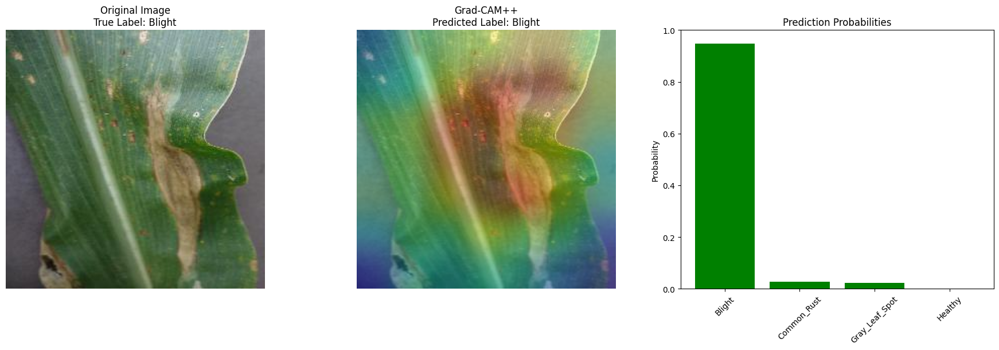

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


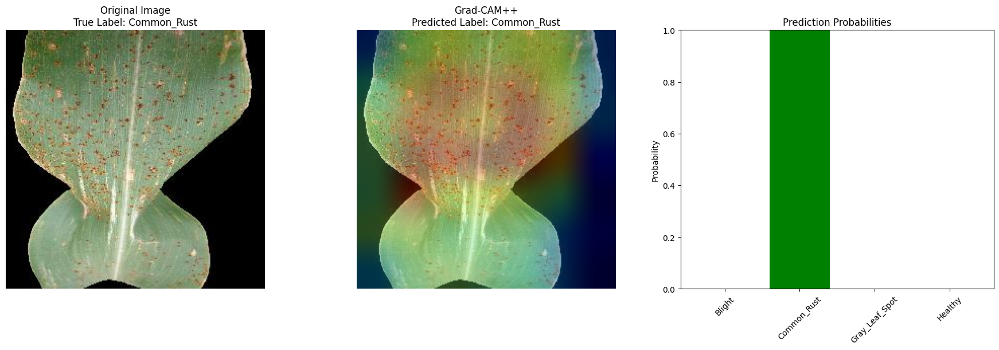

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


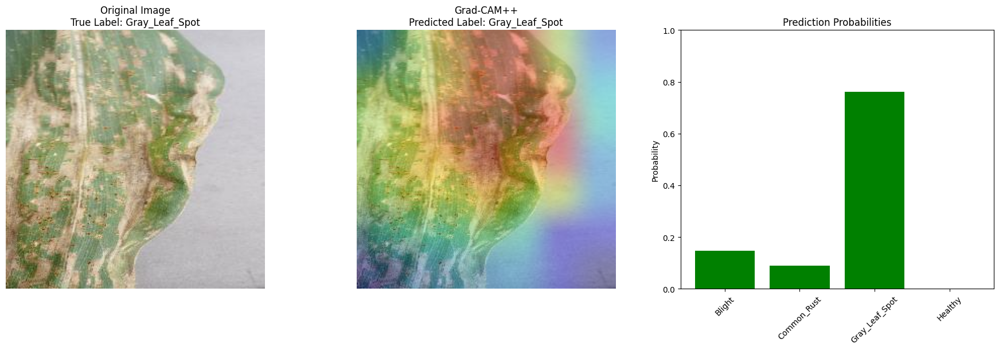

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


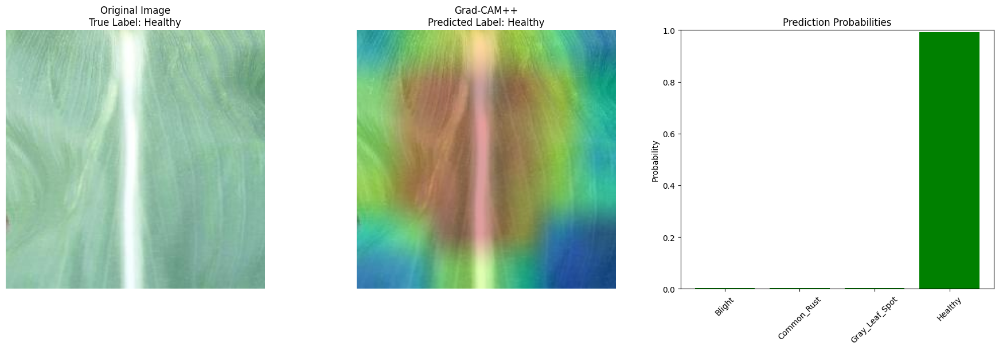

In [52]:
import os
import random
from tensorflow.keras.preprocessing.image import load_img, img_to_array

def get_random_images(test_dir, class_names, img_size):

    random_images = {}
    for class_name in class_names:
        class_dir = os.path.join(test_dir, class_name)
        img_files = os.listdir(class_dir)
        random_img = random.choice(img_files)
        random_images[class_name] = os.path.join(class_dir, random_img)
    return random_images

def visualize_random_images(test_dir, class_names, model, last_conv_layer_name, img_size=224):

    # Get random images from each class
    random_images = get_random_images(test_dir, class_names, img_size)

    for true_label, img_path in random_images.items():
        # Load and preprocess the image
        img_array = get_img_array(img_path, size=img_size)

        # Predict probabilities and class
        predictions = model.predict(img_array)
        predicted_class_probs = predictions[0]
        predicted_class_index = np.argmax(predicted_class_probs)
        predicted_label = class_names[predicted_class_index]

        # Generate Grad-CAM++ heatmap
        heatmap = make_gradcamplus_heatmap(img_array, model, last_conv_layer_name)

        # Plot the visualization
        plot_full_visualization(
            img_path,
            heatmap,
            predicted_class_probs,
            class_names,
            true_label,
            predicted_label
        )

# Define paths and parameters
test_dir = data_dir+'/test'  # Path to your test dataset directory
class_names = ['Blight', 'Common_Rust', 'Gray_Leaf_Spot', 'Healthy']  # Class folder names
last_conv_layer_name = 'Conv_1'  # Last convolutional layer name of MobileNetV2
img_size = 224

# Call the function to visualize
visualize_random_images(test_dir, class_names, model, last_conv_layer_name, img_size=img_size)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


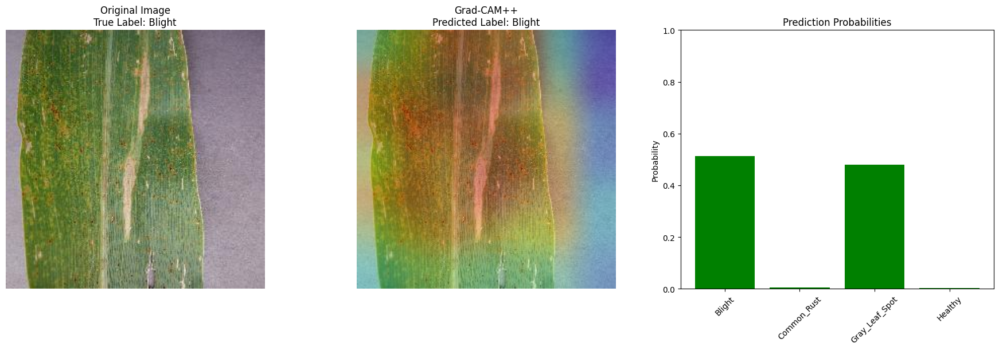

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


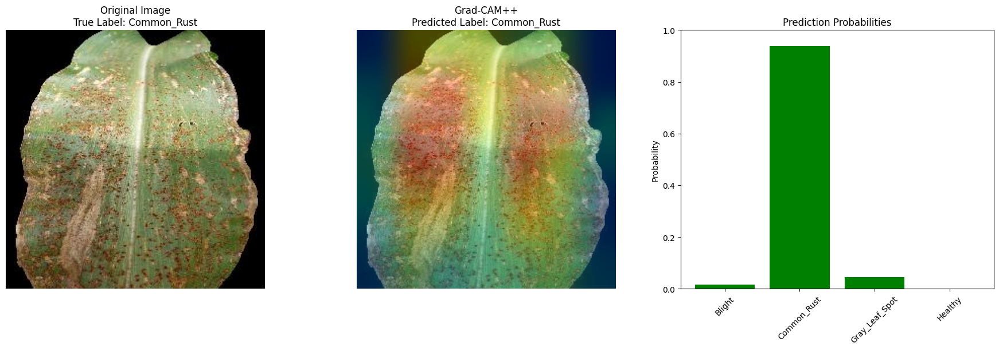

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


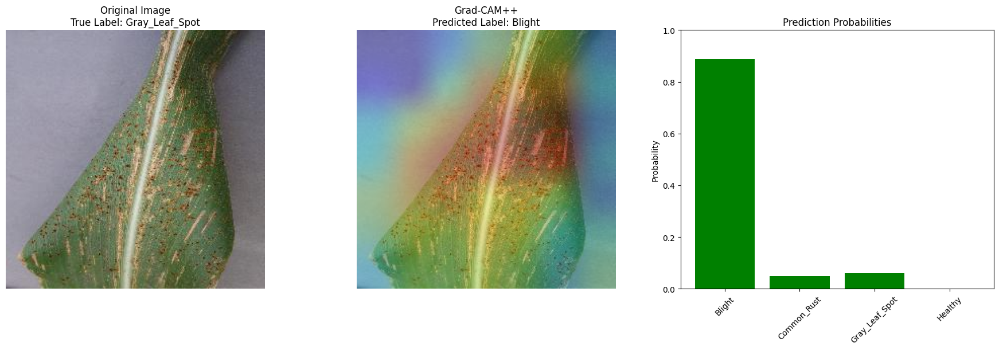

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


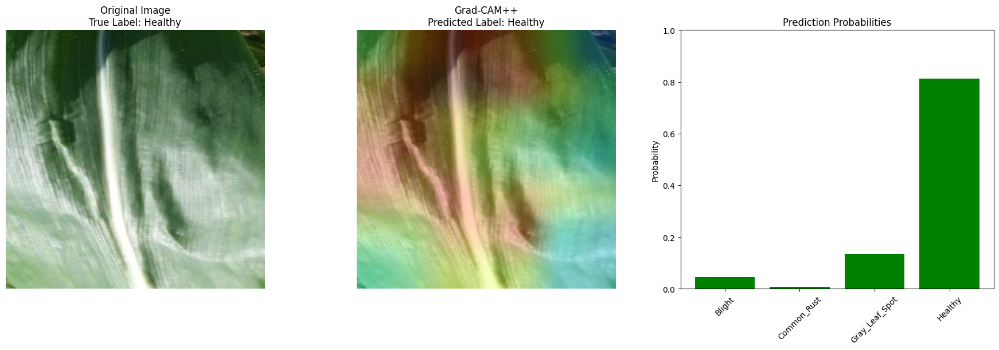

In [ ]:
# Call the function to visualize
visualize_random_images(test_dir, class_names, model, last_conv_layer_name, img_size=img_size)


In [53]:
def plot_full_visualization(img_path, heatmap, probabilities, class_names, true_label, predicted_label, alpha=0.4):

    # Load the original image
    img = tf.keras.preprocessing.image.load_img(img_path)
    img_array = tf.keras.preprocessing.image.img_to_array(img)

    # Apply the heatmap to the image
    heatmap = np.uint8(255 * heatmap)
    jet = cm.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img_array.shape[1], img_array.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    superimposed_img = jet_heatmap * alpha + img_array
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)

    # Create the plots
    fig, ax = plt.subplots(1, 3, figsize=(18, 6))

    # Original image with true label
    ax[0].imshow(img)
    ax[0].axis('off')
    ax[0].set_title(f"Original Image\nTrue Label: {true_label}")

    # Grad-CAM++ heatmap with predicted label
    ax[1].imshow(superimposed_img)
    ax[1].axis('off')
    ax[1].set_title(f"Grad-CAM++\nPredicted Label: {predicted_label}")

    # Bar plot for probabilities
    bar_colors = ['green'] * len(class_names)  # Default color for all bars
    if true_label != predicted_label:
        predicted_index = class_names.index(predicted_label)
        bar_colors[predicted_index] = 'red'  # Mark the predicted class in red if incorrect

    ax[2].bar(range(len(probabilities)), probabilities, color=bar_colors)
    ax[2].set_xticks(range(len(class_names)))
    ax[2].set_xticklabels(class_names, rotation=45)
    ax[2].set_ylim(0, 1)
    ax[2].set_ylabel('Probability')
    ax[2].set_title('Prediction Probabilities')

    plt.tight_layout()
    plt.show()

# Function to visualize random images from the test set
def visualize_random_images(test_dir, class_names, model, last_conv_layer_name, img_size=224):

    # Get random images from each class
    random_images = get_random_images(test_dir, class_names, img_size)

    for true_label, img_path in random_images.items():
        # Load and preprocess the image
        img_array = get_img_array(img_path, size=img_size)

        # Predict probabilities and class
        predictions = model.predict(img_array)
        predicted_class_probs = predictions[0]
        predicted_class_index = np.argmax(predicted_class_probs)
        predicted_label = class_names[predicted_class_index]

        # Generate Grad-CAM++ heatmap
        heatmap = make_gradcamplus_heatmap(img_array, model, last_conv_layer_name)

        # Plot the visualization
        plot_full_visualization(
            img_path,
            heatmap,
            predicted_class_probs,
            class_names,
            true_label,
            predicted_label
        )


In [ ]:
# Lime Implementation

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


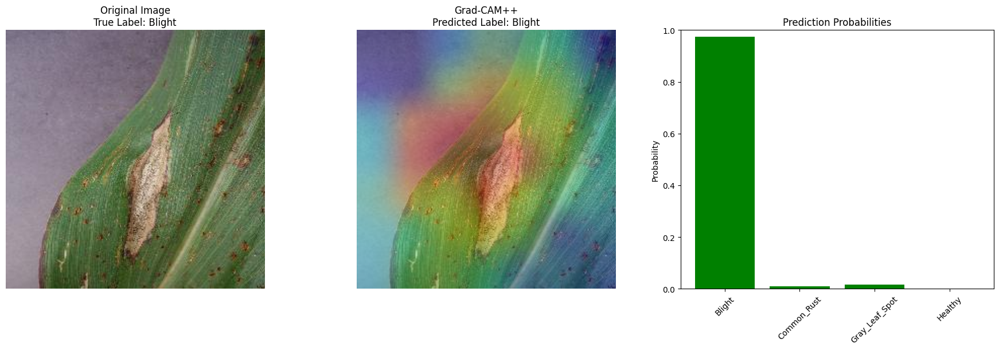

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


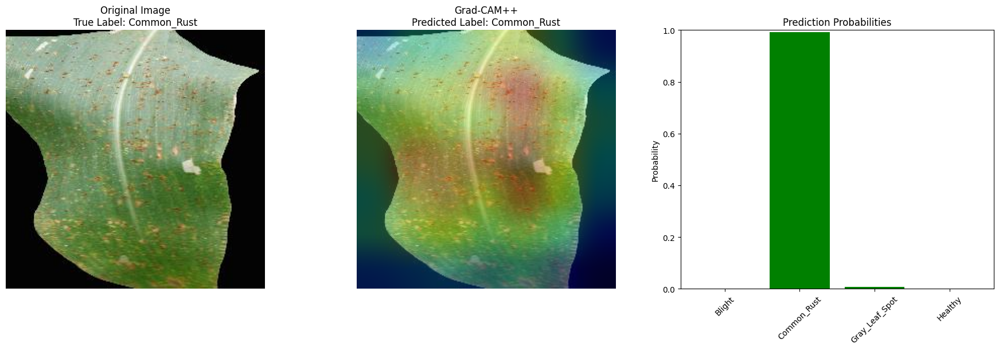

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


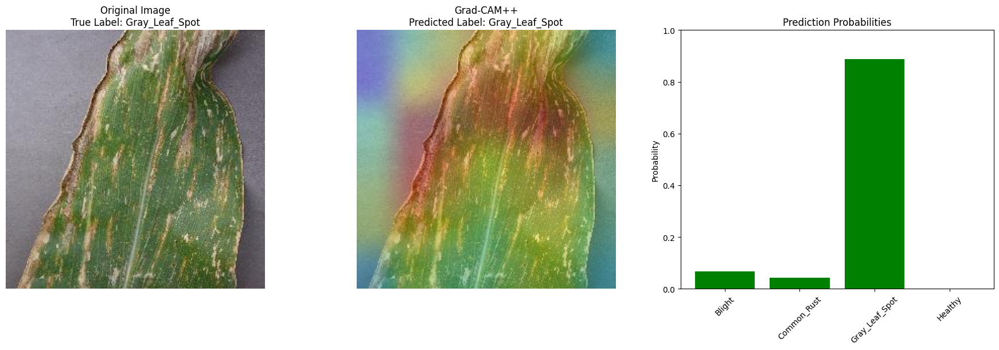

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


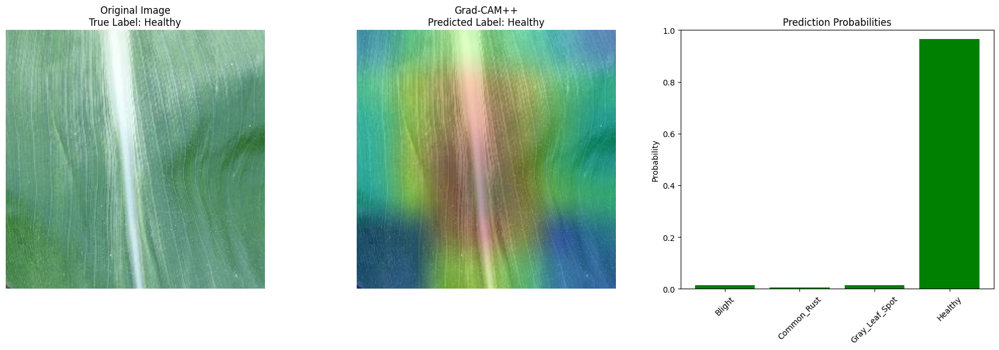

In [54]:
visualize_random_images(test_dir, class_names, model, last_conv_layer_name, img_size=img_size)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


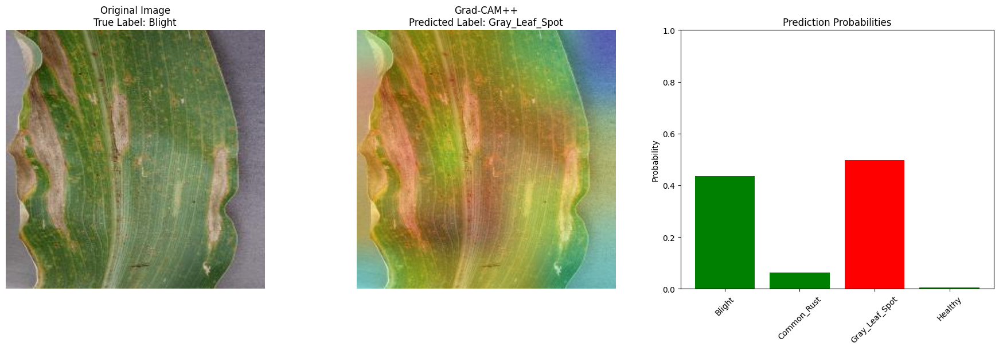

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


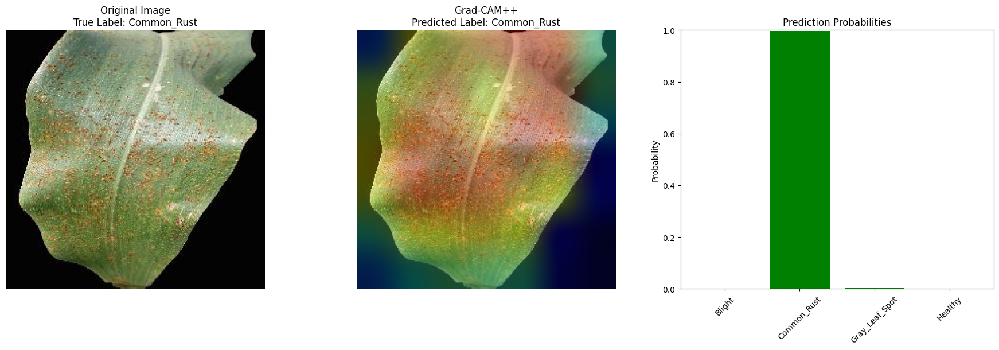

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


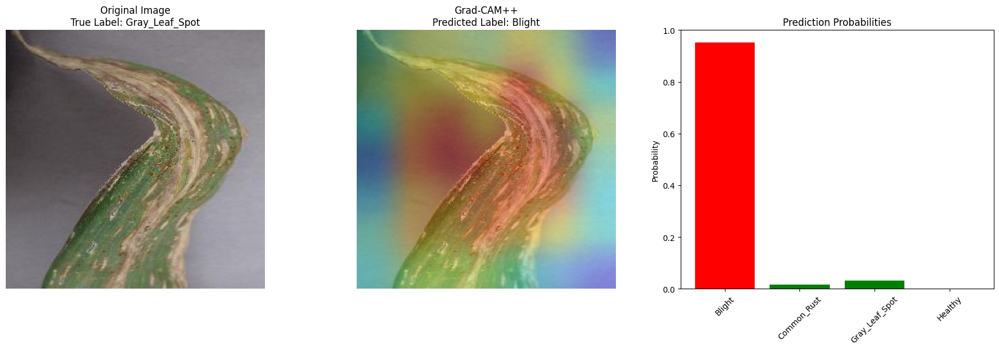

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


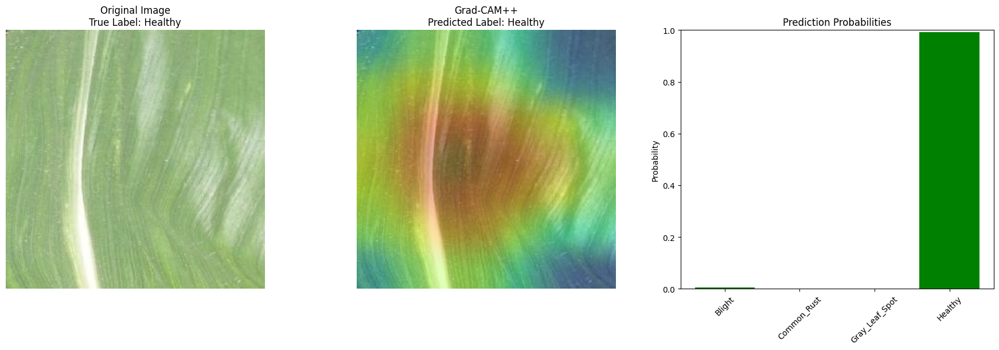

In [55]:
visualize_random_images(test_dir, class_names, model, last_conv_layer_name, img_size=img_size)


In [57]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 6.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=f0f6a6af5dcdc8e1022e79c2c9190b34bbf36673f41bc2756c96a69337414b37
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
# Creating Lime

In [58]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from lime import lime_image
from skimage.segmentation import mark_boundaries
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input as mobilenet_preprocess


In [59]:

# Set your model
model = mobilenetv2_model  # Replace with your trained MobileNetV2 model


In [60]:

# Define preprocessing transform for LIME
def get_preprocess_transform():
    return mobilenet_preprocess  # Use preprocessing for MobileNetV2

preprocess_transform = get_preprocess_transform()


In [61]:

# Define batch prediction function for LIME
def batch_predict(images):
    """
    Applies preprocessing and makes predictions on a batch of images.
    Parameters:
        images (list or numpy array): Batch of images.
    Returns:
        numpy array: Predictions from the model.
    """
    # Preprocess and predict
    images = np.array([preprocess_transform(img) for img in images])
    predictions = model.predict(images)
    return predictions


In [62]:

# Load and preprocess a sample image
def load_image(image_path, target_size=(224, 224)):
    """
    Loads and preprocesses an image for the model.
    Parameters:
        image_path (str): Path to the image.
        target_size (tuple): Target size for resizing.
    Returns:
        numpy array: Preprocessed image.
    """
    img = Image.open(image_path)
    # Convert to RGB if not already
    if img.mode != 'RGB':
        img = img.convert('RGB')
    # Resize to the input size expected by the model
    img = img.resize(target_size)
    return np.array(img)


In [67]:

# Path to the image
# image_path = data_dir+'/test/Common_Rust/Corn_Common_Rust (31).JPG'
image_path = data_dir+'/test/Common_Rust/Corn_Common_Rust (1095).JPG'
input_img = load_image(image_path)


In [68]:

# Initialize LIME image explainer
explainer = lime_image.LimeImageExplainer(random_state=42)

# Get the explanation for the top classes
explanation = explainer.explain_instance(
    input_img,
    batch_predict,  # Function for predicting classes
    top_labels=5,
    hide_color=0,
    num_samples=1000  # Number of perturbed samples
)


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━

In [69]:

# Get class names from your test data generator
# class_names = ['Blight', 'Common_Rust', 'Gray Leaf Spot', 'Healthy']

# Predict the probabilities for the top 5 classes
probs = batch_predict(np.expand_dims(input_img, axis=0))[0]
top5_idx = probs.argsort()[-5:][::-1]

print("Top 5 predictions:")
for idx in top5_idx:
    print(f"Class {class_names[idx]}: {probs[idx]:.4f}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
Top 5 predictions:
Class Common_Rust: 0.9093
Class Gray_Leaf_Spot: 0.0455
Class Blight: 0.0452
Class Healthy: 0.0000


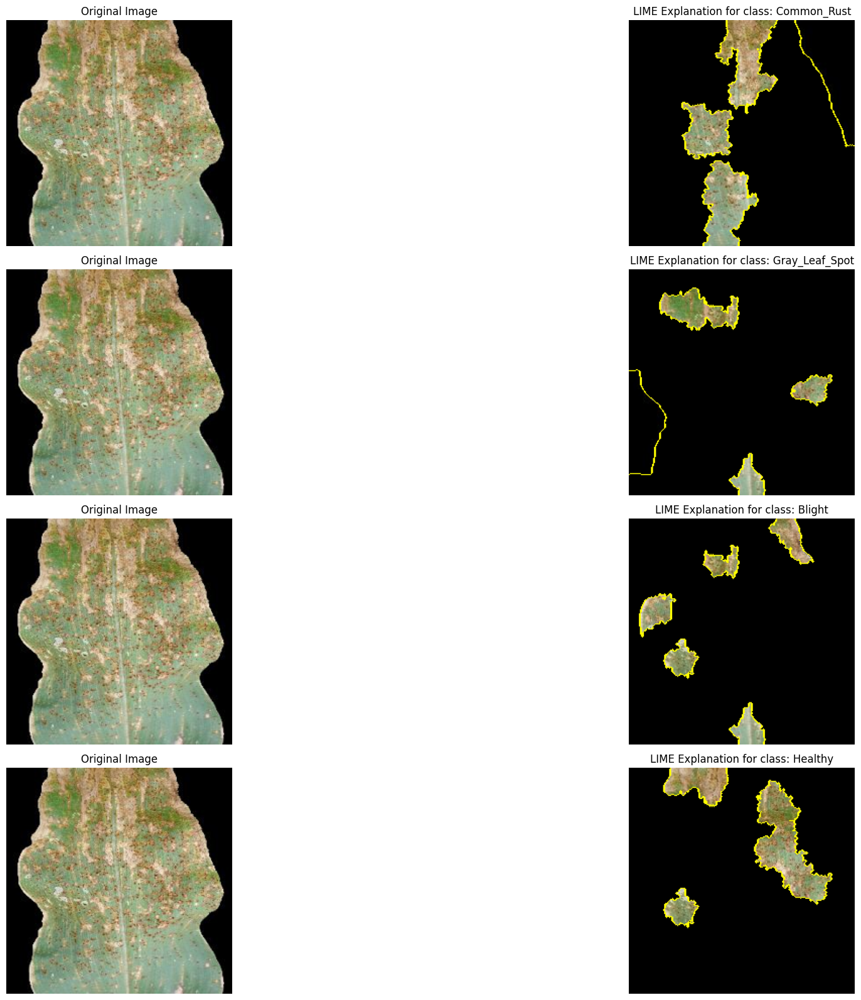

In [70]:

# Visualize explanations for the top 5 predicted classes
plt.figure(figsize=(20, 4 * 5))
for idx, label in enumerate(explanation.top_labels):
    # Get the image and mask for the label
    temp, mask = explanation.get_image_and_mask(
        label, positive_only=True, num_features=5, hide_rest=True
    )

    img_boundary = mark_boundaries(temp / 255.0, mask)

    plt.subplot(5, 2, 2 * idx + 1)
    plt.imshow(input_img)
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(5, 2, 2 * idx + 2)
    plt.imshow(img_boundary)
    class_name = class_names[label]  # Map label index to class name
    plt.title(f"LIME Explanation for class: {class_name}")
    plt.axis('off')

plt.tight_layout()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


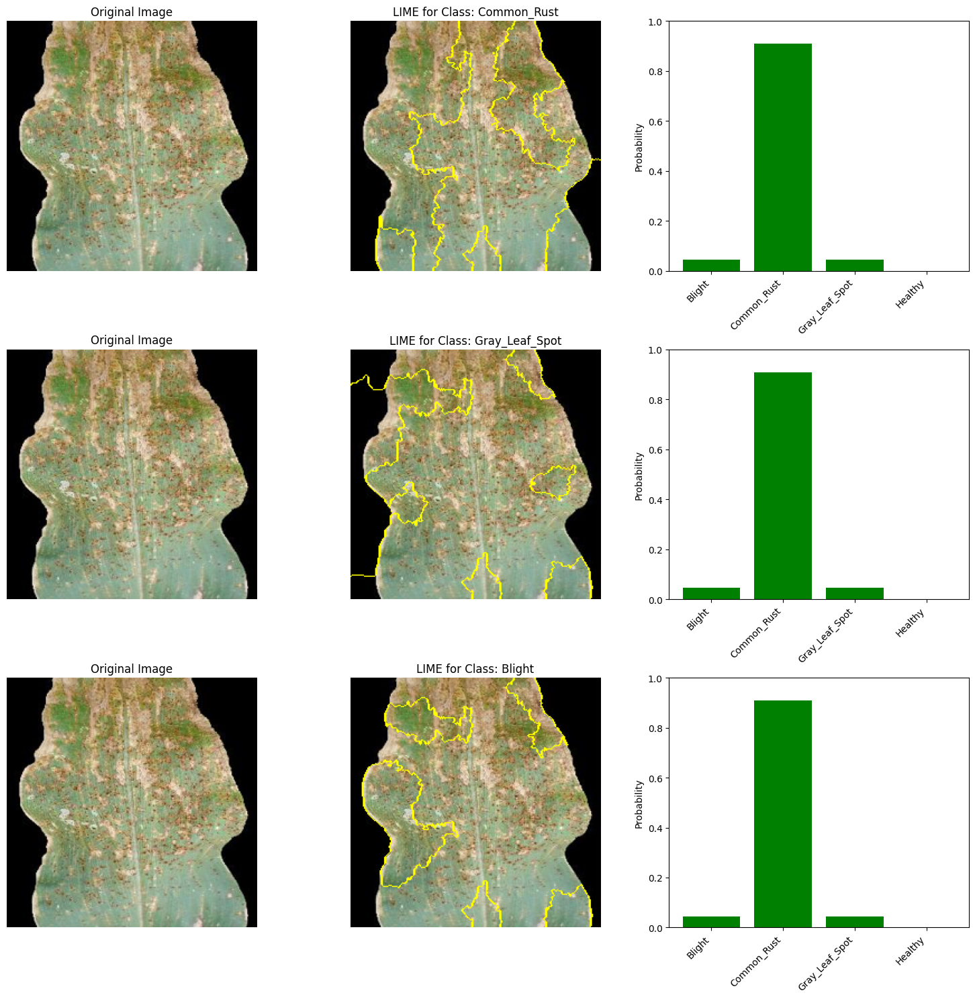

In [72]:
# def visualize_lime_explanation(input_img, explanation, class_names, probabilities, top_k=3):

#     # Get the top-k classes for visualization
#     top_labels = explanation.top_labels[:top_k]
#     top_probs = probabilities[top_labels]

#     fig, axes = plt.subplots(len(top_labels), 3, figsize=(15, 5 * len(top_labels)))

#     if len(top_labels) == 1:
#         axes = [axes]  # Ensure axes are iterable for a single label

#     for idx, label in enumerate(top_labels):
#         # Get the image and mask for the label
#         temp, mask = explanation.get_image_and_mask(
#             label, positive_only=True, num_features=10, hide_rest=False
#         )
#         img_boundary = mark_boundaries(temp / 255.0, mask)

#         # Plot the original image
#         axes[idx][0].imshow(input_img)
#         axes[idx][0].set_title("Original Image")
#         axes[idx][0].axis('off')

#         # Plot the LIME explanation
#         axes[idx][1].imshow(img_boundary)
#         axes[idx][1].set_title(f"LIME for Class: {class_names[label]}")
#         axes[idx][1].axis('off')

#         # Plot the class probabilities
#         # axes[idx][2].barh(class_names, probabilities, color='blue')
#         # axes[idx][2].barh(class_names[label], probabilities[label], color='green')
#         axes[idx][2].bar(class_names, probabilities, color='green')
#         axes[idx][2].bar(class_names[label], probabilities[label], color='green')
#         axes[idx][2].set_ylim(0, 1)
#         axes[idx][2].set_ylabel("Probability")
#         axes[idx][2].set_xticks(range(len(class_names)))
#         axes[idx][2].set_xticklabels(class_names, rotation=45, ha="right")
#         # axes[idx][2].set_xlim(0, 1)
#         # axes[idx][2].set_title("Class Probabilities")
#         # axes[idx][2].set_xlabel("Probability")

#     plt.tight_layout()
#     plt.show()



# # Predict the probabilities for the image
# probs = batch_predict(np.expand_dims(input_img, axis=0))[0]

# # Visualize the LIME explanation
# visualize_lime_explanation(input_img, explanation, class_names, probs, top_k=3)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


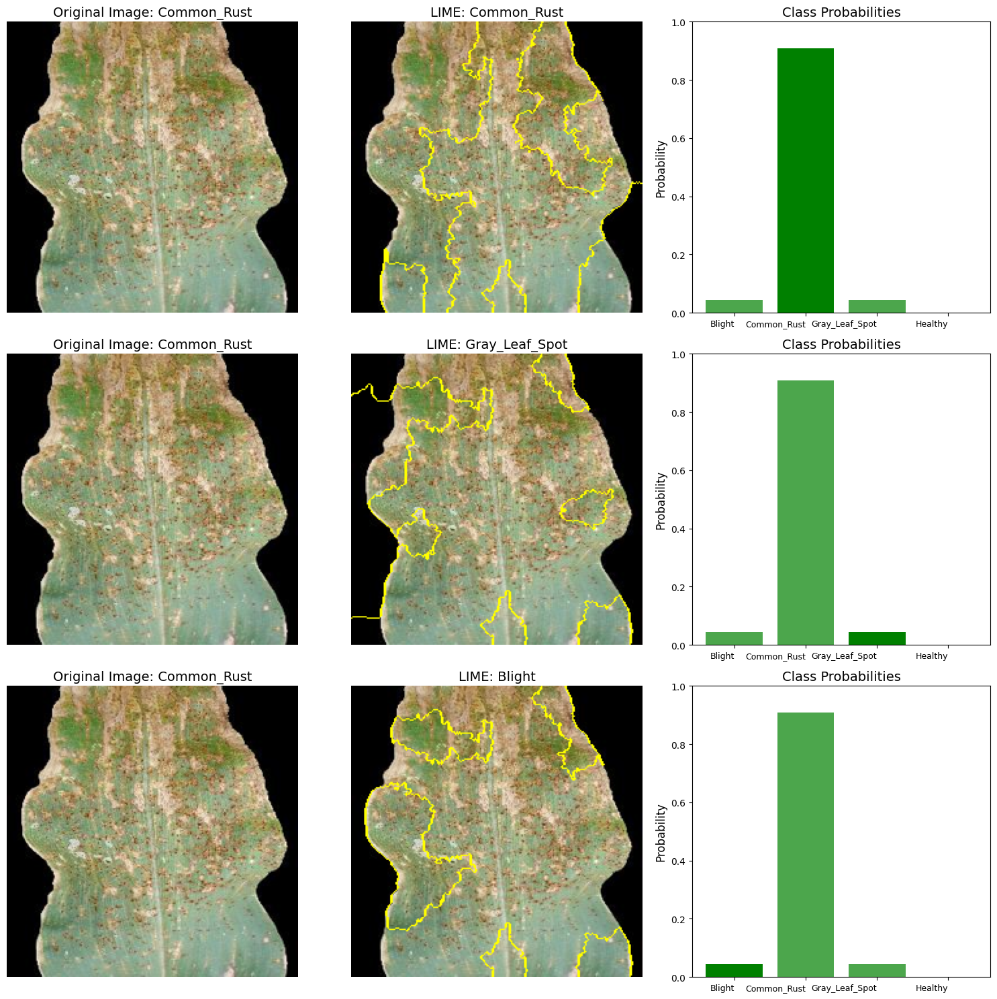

In [78]:
def visualize_lime_explanation(input_img, explanation, class_names, probabilities, true_label, top_k=3):
    # Get the top-k classes for visualization
    top_labels = explanation.top_labels[:top_k]
    top_probs = probabilities[top_labels]

    # Ensure all classes are included in the probability chart
    num_classes = len(class_names)

    fig, axes = plt.subplots(len(top_labels), 3, figsize=(15, 5 * len(top_labels)))

    if len(top_labels) == 1:
        axes = [axes]  # Ensure axes are iterable for a single label

    for idx, label in enumerate(top_labels):
        # Get the image and mask for the label
        temp, mask = explanation.get_image_and_mask(
            label, positive_only=True, num_features=10, hide_rest=False
        )
        img_boundary = mark_boundaries(temp / 255.0, mask)

        # Plot the original image
        axes[idx][0].imshow(input_img)
        axes[idx][0].set_title(f"Original Image: {class_names[true_label]}", fontsize=14)
        axes[idx][0].axis('off')

        # Plot the LIME explanation
        axes[idx][1].imshow(img_boundary)
        axes[idx][1].set_title(f"LIME: {class_names[label]}", fontsize=14)
        axes[idx][1].axis('off')

        # Plot the class probabilities
        axes[idx][2].bar(class_names, probabilities, color='green', alpha=0.7)
        axes[idx][2].bar(class_names[label], probabilities[label], color='green', alpha=1.0)  # Highlight the top class
        axes[idx][2].set_ylim(0, 1)
        axes[idx][2].set_ylabel("Probability", fontsize=12)
        axes[idx][2].set_xticks(range(num_classes))
        axes[idx][2].set_xticklabels(class_names, ha="right", fontsize=9)
        axes[idx][2].set_title("Class Probabilities", fontsize=14)

    plt.tight_layout()
    plt.show()


# Predict the probabilities for the image
probs = batch_predict(np.expand_dims(input_img, axis=0))[0]

# Visualize the LIME explanation
true_label = 1  # Example: Set the true label index
visualize_lime_explanation(input_img, explanation, class_names, probs, true_label, top_k=3)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


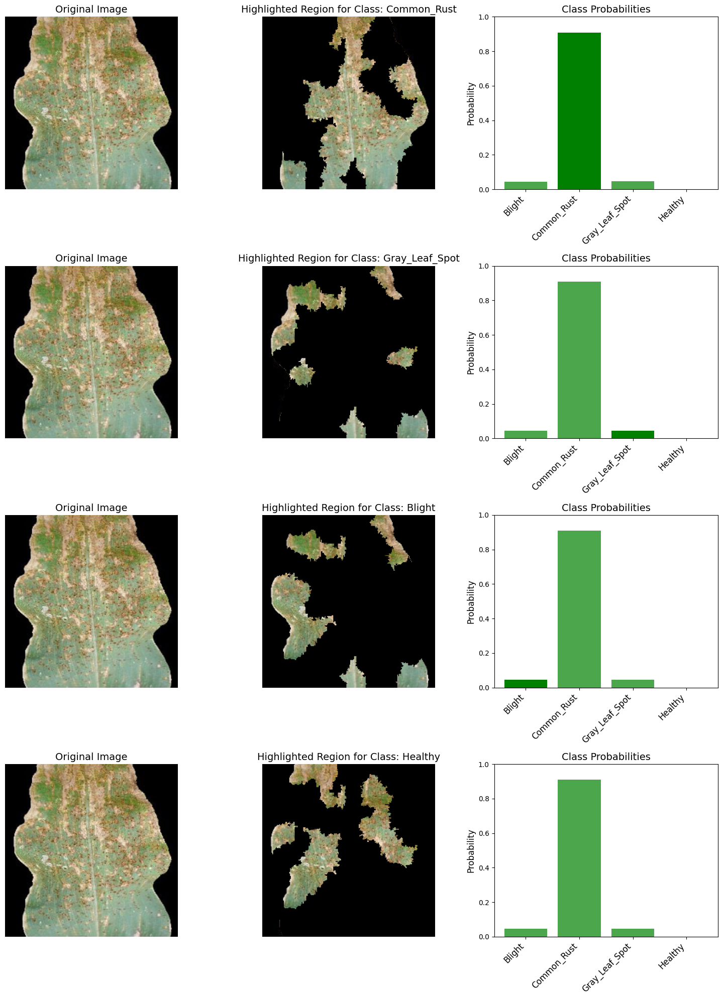

In [82]:
# def visualize_lime_explanation_highlighted(input_img, explanation, class_names, probabilities, top_k=3):
#     # Get the top-k classes for visualization
#     top_labels = explanation.top_labels[:top_k]

#     fig, axes = plt.subplots(len(top_labels), 3, figsize=(15, 5 * len(top_labels)))

#     if len(top_labels) == 1:
#         axes = [axes]  # Ensure axes are iterable for a single label

#     for idx, label in enumerate(top_labels):
#         # Get the image and mask for the label
#         temp, mask = explanation.get_image_and_mask(
#             label, positive_only=True, num_features=10, hide_rest=True
#         )

#         # Apply the mask to the input image (highlight only the important regions)
#         highlighted_img = np.zeros_like(input_img)
#         highlighted_img[mask == 1] = input_img[mask == 1]

#         # Plot the original image
#         axes[idx][0].imshow(input_img)
#         axes[idx][0].set_title("Original Image")
#         axes[idx][0].axis('off')

#         # Plot the highlighted image with blacked-out regions
#         axes[idx][1].imshow(highlighted_img)
#         axes[idx][1].set_title(f"Highlighted Region for Class: {class_names[label]}")
#         axes[idx][1].axis('off')

#         # Plot the class probabilities
#         axes[idx][2].barh(class_names, probabilities, color='blue')
#         axes[idx][2].barh(class_names[label], probabilities[label], color='green')
#         axes[idx][2].set_xlim(0, 1)
#         axes[idx][2].set_title("Class Probabilities")
#         axes[idx][2].set_xlabel("Probability")

#     plt.tight_layout()
#     plt.show()


# # Predict the probabilities for the image
# probs = batch_predict(np.expand_dims(input_img, axis=0))[0]

# # Visualize the LIME explanation with highlighted regions
# visualize_lime_explanation_highlighted(input_img, explanation, class_names, probs, top_k=3)

def visualize_lime_explanation_highlighted(input_img, explanation, class_names, probabilities, top_k=3):
    # Get the top-k classes for visualization
    top_labels = explanation.top_labels[:top_k]

    fig, axes = plt.subplots(len(top_labels), 3, figsize=(15, 5 * len(top_labels)))

    if len(top_labels) == 1:
        axes = [axes]  # Ensure axes are iterable for a single label

    for idx, label in enumerate(top_labels):
        # Get the image and mask for the label
        temp, mask = explanation.get_image_and_mask(
            label, positive_only=True, num_features=10, hide_rest=True
        )

        # Apply the mask to the input image (highlight only the important regions)
        highlighted_img = np.zeros_like(input_img)
        highlighted_img[mask == 1] = input_img[mask == 1]

        # Plot the original image
        axes[idx][0].imshow(input_img)
        axes[idx][0].set_title("Original Image", fontsize=14)
        axes[idx][0].axis('off')

        # Plot the highlighted image with blacked-out regions
        axes[idx][1].imshow(highlighted_img)
        axes[idx][1].set_title(f"Highlighted Region for Class: {class_names[label]}", fontsize=14)
        axes[idx][1].axis('off')

        # Plot the class probabilities (vertical bar plot)
        axes[idx][2].bar(class_names, probabilities, color='green', alpha=0.7)
        axes[idx][2].bar(class_names[label], probabilities[label], color='green', alpha=1.0)  # Highlight top class
        axes[idx][2].set_ylim(0, 1)  # Set y-axis range for probabilities
        axes[idx][2].set_title("Class Probabilities", fontsize=14)
        axes[idx][2].set_ylabel("Probability", fontsize=12)
        axes[idx][2].set_xticks(range(len(class_names)))
        axes[idx][2].set_xticklabels(class_names, rotation=45, ha="right", fontsize=12)

    plt.tight_layout()
    plt.show()


# Predict the probabilities for the image
probs = batch_predict(np.expand_dims(input_img, axis=0))[0]

# Visualize the LIME explanation with highlighted regions
visualize_lime_explanation_highlighted(input_img, explanation, class_names, probs, top_k=4)


In [86]:
from PIL import Image
import numpy as np

def load_image(image_path, target_size=(224, 224)):
    img = Image.open(image_path)
    img = img.convert("RGB")  # Ensure the image is in RGB format
    img = img.resize(target_size)  # Resize to the target size
    return np.array(img)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


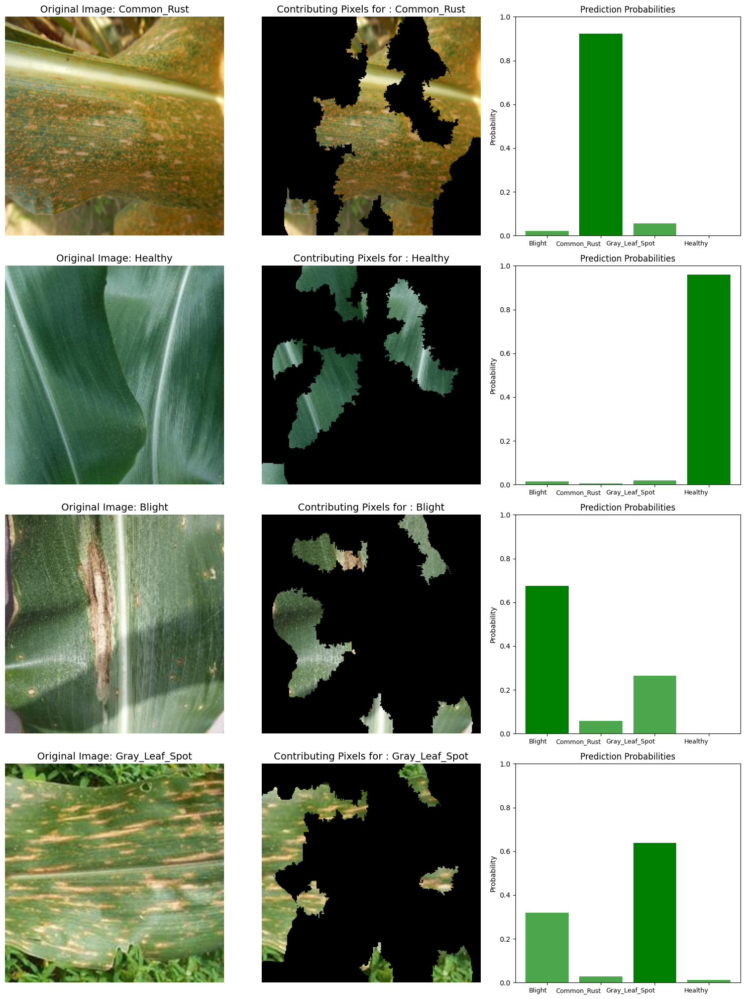

In [112]:
def visualize_lime_for_multiple_images(image_paths, model, class_names, explainer, last_conv_layer_name):

    fig, axes = plt.subplots(len(image_paths), 3, figsize=(15, 5 * len(image_paths)))

    for i, image_path in enumerate(image_paths):
        # Load and preprocess the image
        input_img = load_image(image_path)
        img_array = np.expand_dims(input_img, axis=0)

        # Predict probabilities
        probs = batch_predict(img_array)[0]
        predicted_label = np.argmax(probs)
        predicted_class_name = class_names[predicted_label]


        temp, mask = explanation.get_image_and_mask(
            predicted_label, positive_only=True, num_features=10, hide_rest=False
        )

        # Highlighted image
        highlighted_img = np.zeros_like(input_img)
        highlighted_img[mask == 1] = input_img[mask == 1]

        # Plot the original image
        axes[i][0].imshow(input_img)
        axes[i][0].set_title(f"Original Image: {class_names[predicted_label]}", fontsize=14)
        axes[i][0].axis('off')

        # Plot the highlighted image
        axes[i][1].imshow(highlighted_img)
        axes[i][1].set_title(f"Contributing Pixels for : {predicted_class_name}", fontsize=14)
        axes[i][1].axis('off')

        # Plot the class probabilities (vertical bar plot)
        axes[i][2].bar(class_names, probs, color='green', alpha=0.7)
        axes[i][2].bar(class_names[predicted_label], probs[predicted_label], color='green', alpha=1.0)
        axes[i][2].set_ylim(0, 1)  # Set y-axis range for probabilities
        axes[i][2].set_title("Prediction Probabilities", fontsize=12)
        axes[i][2].set_ylabel("Probability", fontsize=10)
        axes[i][2].set_xticks(range(len(class_names)))
        axes[i][2].set_xticklabels(class_names, ha="right", fontsize=9)

    plt.tight_layout()
    plt.show()


# Example Usage
image_paths = [
    # data_dir"/test/Common_Rust/Corn_Common_Rust (31).jpg",
    # data_dir+"/test/Common_Rust/Corn_Common_Rust (1285).jpg",
    # data_path+"/Healthy/Corn_Health (9).jpg",
    # data_path+ "/Blight/Corn_Blight (1000).JPG",
    # data_path+"/Gray_Leaf_Spot/Corn_Gray_Spot (161).JPG"

    data_path+"/Common_Rust/Corn_Common_Rust (31).jpg",  # Replace with your image paths
    data_path+"/Healthy/Corn_Health (9).jpg",
    data_path+"/Blight/Corn_Blight (985).JPG",
    data_path+"/Gray_Leaf_Spot/Corn_Gray_Spot (11).jpg"
]


# Visualize LIME for the images
visualize_lime_for_multiple_images(image_paths, model, class_names, explainer, last_conv_layer_name="Conv_1")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


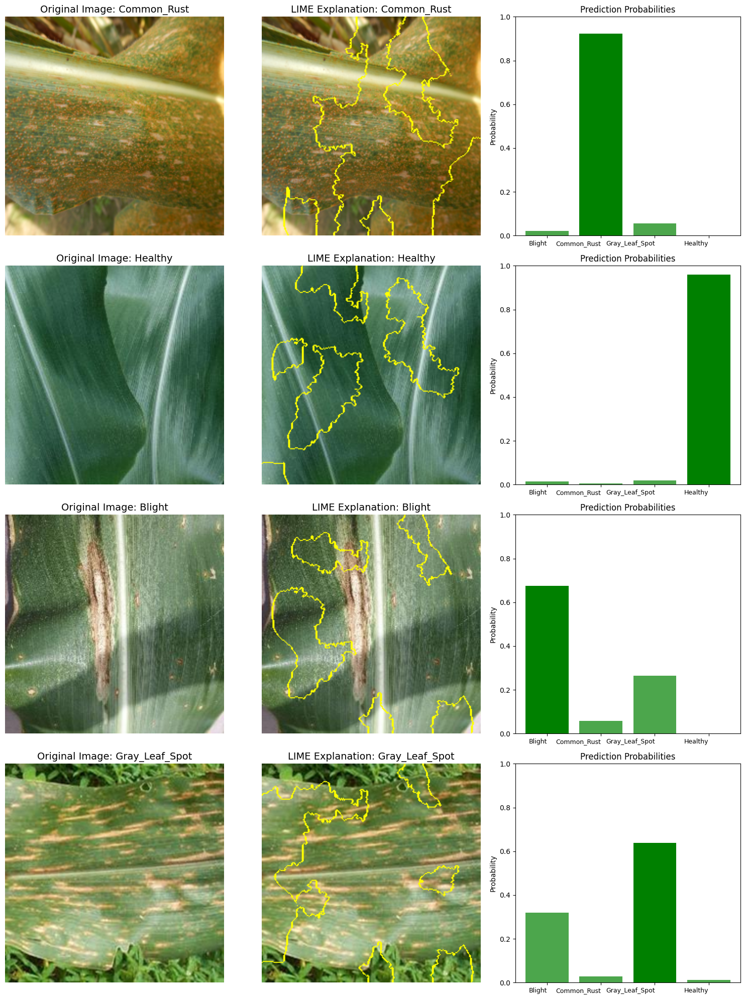

In [111]:
def visualize_lime_without_blackout(image_paths, model, class_names, explainer):


    fig, axes = plt.subplots(len(image_paths), 3, figsize=(15, 5 * len(image_paths)))

    for i, image_path in enumerate(image_paths):
        # Load and preprocess the image
        input_img = load_image(image_path)
        img_array = np.expand_dims(input_img, axis=0)

        # Predict probabilities
        probs = batch_predict(img_array)[0]
        predicted_label = np.argmax(probs)
        predicted_class_name = class_names[predicted_label]


        # Get the image and mask for the predicted label
        temp, mask = explanation.get_image_and_mask(
            predicted_label, positive_only=True, num_features=10, hide_rest=False
        )

        # Ensure the temp matches the input image
        temp = input_img.copy()  # Use the original image for overlay

        # Create LIME explanation image with boundaries
        lime_image_with_boundaries = mark_boundaries(temp / 255.0, mask)

        # Plot the original image
        axes[i][0].imshow(input_img)
        axes[i][0].set_title(f"Original Image: {class_names[predicted_label]}", fontsize=14)
        axes[i][0].axis('off')

        # Plot the LIME explanation image with boundaries
        axes[i][1].imshow(lime_image_with_boundaries)
        axes[i][1].set_title(f"LIME Explanation: {predicted_class_name}", fontsize=14)
        axes[i][1].axis('off')

        # Plot the class probabilities (vertical bar plot)
        axes[i][2].bar(class_names, probs, color='green', alpha=0.7)
        axes[i][2].bar(class_names[predicted_label], probs[predicted_label], color='green', alpha=1.0)
        axes[i][2].set_ylim(0, 1)  # Set y-axis range for probabilities
        axes[i][2].set_title("Prediction Probabilities", fontsize=12)
        axes[i][2].set_ylabel("Probability", fontsize=10)
        axes[i][2].set_xticks(range(len(class_names)))
        axes[i][2].set_xticklabels(class_names, ha="right", fontsize=9)

    plt.tight_layout()
    plt.show()


# Example Usage
image_paths = [
    data_path+"/Common_Rust/Corn_Common_Rust (31).jpg",  # Replace with your image paths
    data_path+"/Healthy/Corn_Health (9).jpg",
    data_path+"/Blight/Corn_Blight (985).JPG",
    data_path+"/Gray_Leaf_Spot/Corn_Gray_Spot (11).jpg"
]



# Visualize LIME for the images
visualize_lime_without_blackout(image_paths, model, class_names, explainer)
